# Домашнее задание 4 (base): авторегрессионные модели и мультимодальность

В этом домашнем задании вам предлагается обучить авторегрессионную модель для генерации изображений (PixelCNN), а также сделать подход мультимодальным,  обусловив модель на CLIP-эмбеддинги.

# Рекомендации (sanity check) по обучению модели

1) Обучите вашу модель на выборке из 100 картинок (первые 100 из датасета) + всех возможных кепшенов для них. Модель должна переобучится под эти 100 картинки и выдавать очень низкий bpd и генерить хорошие картинки. Это санити чек для задачи 4 и 5. Оставьте этот ран в ноутбуке, чтобы мы тоже видели (постарайтесь сделать это красиво, не копипастя все клетки ноутбука, а именно конфигурируя эксперимент)

2) Идем на весь датасет, чтобы научиться обобщаться на разные картинки и промпты. Хорошая в рамках дз модель должна научится как минимум рисовать background-ы и иногда показывать очертания птиц. Чтобы птицы (или что-то на них похожее) стали более видны (и cond и uncond), используйте температуру при сэмплировании (подумайте почему это влияет). Будет заметно влиятнее промпта

В задаче можно точно выбить bpd в 8.9 — как ориентир после долгого обучения. 9.8 должно выбиваться довольно быстро.

### Задание 1 (0 баллов)

Скачайте [датасет про птиц с HuggingFace](https://huggingface.co/datasets/weiywang/CUB_200_2011_CAP).

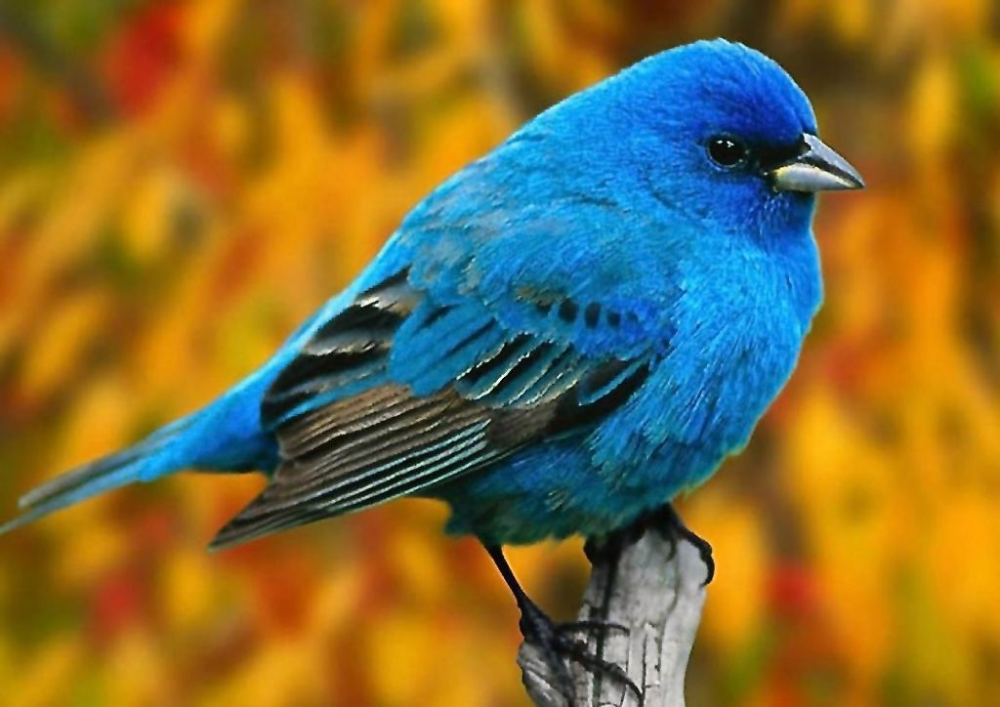

In [ ]:
!pip install --quiet pytorch-lightning>=1.4 open_clip_torch

In [ ]:
# все импорты
import torch
import numpy as np
from torch.utils.data import DataLoader
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from torchvision import transforms
import open_clip
from scipy.linalg import sqrtm
from torchvision.models import inception_v3
from torchvision.transforms import ToPILImage

import warnings
warnings.filterwarnings('ignore')

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

In [ ]:
from datasets import load_dataset

ds = load_dataset("weiywang/CUB_200_2011_CAP")

README.md:   0%|          | 0.00/372 [00:00<?, ?B/s]

data/train-00000-of-00003.parquet:   0%|          | 0.00/385M [00:00<?, ?B/s]

data/train-00001-of-00003.parquet:   0%|          | 0.00/387M [00:00<?, ?B/s]

data/train-00002-of-00003.parquet:   0%|          | 0.00/376M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/11787 [00:00<?, ? examples/s]

### UPD: VQ-VAE

VQ-VAE - это автоэнкодер, который позволяет сжимать большие входные изображения в дискретное латентное пространство (последовательность кодов) и декодировать их обратно (см. рис).

<img src="https://substackcdn.com/image/fetch/$s_!dRiM!,f_auto,q_auto:good,fl_progressive:steep/https%3A%2F%2Fsubstack-post-media.s3.amazonaws.com%2Fpublic%2Fimages%2F81630fcc-b23e-4f06-831f-690aff70e03b_1215x476.png" width="800" height="400">

VQ-VAE состоит из трех частей. Энкодер кодирует входное изображение $x \in \mathbb{R}^{B \times C \times H \times W}$ в непрерывное латентное пространство $z_e \in \mathbb{R}^{B \times D \times H_{h} \times W_{h}}$. Quantizer смотрит на каждый вектор из $z_e$ ($H_{h} \times W_{h}$ штук длины $D$) и заменяет их на ближайший похожий вектор из словаря-векторов (codebook), который обучался вместе с моделью. Сам $z_e$после такой операции заменяется на $z_q$ (те же размеры, но каждый вектор заменен на ближайшего из кодбука). $z_q$ можно хранить либо как непрерывный тензор $\mathbb{R}^{B \times D \times H_{h} \times W_{h}}$, либо просто хранить $B \times  H_{h} \times W_{h}$ дискретных индексов из кодбука, где индексы соответствуют номеру вектора в кодбуке (для примера, если у нас 4096 векторов в кодбуке и мы $z_e$ заменили на вектора на местах $1, 2000, 2, 10$ из кодбука, то теперь $z_q$ в дискретном виде это просто массив $1, 200, 2, 10$). Декодер, последняя часть VQ-VAE, берет $z_q$ и переводит из кодов обратно в вектора из кодбука (если $z_q$ был в виде кодов, а не векторов) и прогоняет $z_q$ через набор слоев, чтобы получить изображение $\hat{x} \simeq x$.


$H_{h} \times W_{h}$ как правило сильно меньше оригинальных $H \times W$, поэтому многие генеративные модели используют VQ-VAE для генерации высококачественных изображений без значительного усложнения вычислительной сложности. Действительно, если вместо авторегрессионной генерации $С \times H \times W$, где $H, W \ge 128$ мы будем работать с дискретным тензором $H_{h} \times W_{h}$, где $H_h, W_h \le 32$, то мы сможем генерировать качественные изображения с той же вычислительной сложностью как если бы сделали resize изначальных картинок в $32\times32$, но при этом не теряем в качестве изображений (ведь финальное изображение получается прогоном кодов через декодер).

Давайте посмотрим как это работает:

In [11]:
# Скачаем предобученную VQ-VAE

from diffusers import VQModel
vqvae = VQModel.from_pretrained("microsoft/vq-diffusion-ithq", subfolder="vqvae")
vqvae.to(device)

An error occurred while trying to fetch microsoft/vq-diffusion-ithq: microsoft/vq-diffusion-ithq does not appear to have a file named diffusion_pytorch_model.safetensors.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


VQModel(
  (encoder): Encoder(
    (conv_in): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (down_blocks): ModuleList(
      (0): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0-1): 2 x ResnetBlock2D(
            (norm1): GroupNorm(32, 64, eps=1e-06, affine=True)
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (norm2): GroupNorm(32, 64, eps=1e-06, affine=True)
            (dropout): Dropout(p=0.0, inplace=False)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (nonlinearity): SiLU()
          )
        )
        (downsamplers): ModuleList(
          (0): Downsample2D(
            (conv): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2))
          )
        )
      )
      (1): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0): ResnetBlock2D(
            (norm1): GroupNorm(32, 64, eps=1e-06, affine=True)
            (conv1): Conv2d(64

Скачаем картинку для примера

In [ ]:
!wget "https://upload.wikimedia.org/wikipedia/commons/1/16/Myophonus_caeruleus_-_Ang_Khang_edit1.jpg" -O example.jpg

--2025-11-28 11:59:39--  https://upload.wikimedia.org/wikipedia/commons/1/16/Myophonus_caeruleus_-_Ang_Khang_edit1.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 198.35.26.112, 2620:0:863:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|198.35.26.112|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1474949 (1.4M) [image/jpeg]
Saving to: ‘example.jpg’

example.jpg         100%[===================>]   1.41M  --.-KB/s    in 0.1s    

2025-11-28 11:59:39 (11.8 MB/s) - ‘example.jpg’ saved [1474949/1474949]



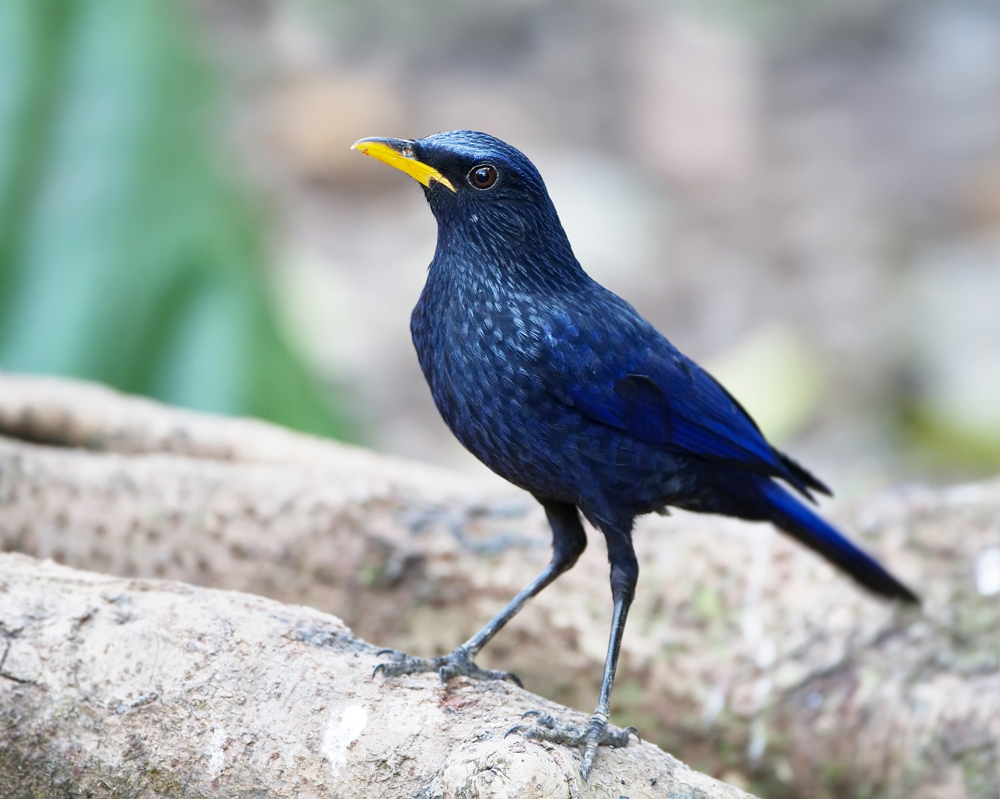

In [ ]:
from PIL import Image

img = Image.open("example.jpg")
img

VQ-VAE этот работает на изображениях $256\times 256$, поэтому ресайзим

In [ ]:
img.width

2273

In [ ]:
img.height

1818

In [ ]:
from torchvision import transforms

x = transforms.Resize((256, 256))(img)
x = transforms.ToTensor()(x)
x.shape

torch.Size([3, 256, 256])

Код для получения кодов и декодирования изображения:

In [12]:
def img_to_codes(x, vqvae):
    if x.ndim != 4:
        x = x.unsqueeze(0)
    # для нормализации вход не [0, 1], а [-1, 1]
    x = x * 2 - 1
    # применяем энкодер
    latent = vqvae.encode(x).latents
    # получаем z_q и соответствующие коды
    quant, commit_loss, (_, _, indices) = vqvae.quantize(latent)
    # коды тут flatten, решейпим обратно
    B, _, Hc, Wc = latent.shape
    if indices.dim() == 1:
        codes = indices.view(B, Hc, Wc)
    else:
        codes = indices
    return codes

def codes_to_img(codes, vqvae):
    B, Hc, Wc = codes.shape
    codes = codes.view(-1)
    # получаем непрерывное z_q из соответствующих кодов,
    # смотря на вектора из кодбука по индексам
    quant = vqvae.quantize.get_codebook_entry(
        codes,
        shape=(B, Hc, Wc, vqvae.quantize.vq_embed_dim)  # (B, H, W, C)
    )
    # декодируем
    quant2 = vqvae.post_quant_conv(quant)
    dec = vqvae.decoder(quant2, quant if vqvae.config.norm_type == "spatial" else None)
    return (dec + 1) / 2

Применим:

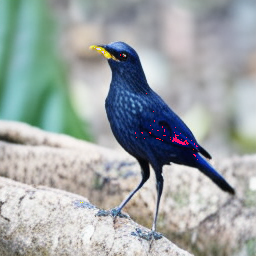

In [ ]:
codes = img_to_codes(x.to(device), vqvae)
hat_x = codes_to_img(codes, vqvae)
transforms.ToPILImage()(hat_x[0])

In [ ]:
codes

tensor([[[ 817, 2035, 1131,  ..., 2121, 3251,  308],
         [ 959, 3175, 3348,  ...,  798,  890,  626],
         [4008,  485, 1446,  ...,  300, 2945,  113],
         ...,
         [1287, 3999, 2154,  ..., 1070, 2207, 1166],
         [3132, 4010,  896,  ...,  729, 2359, 3617],
         [1282, 1434, 3435,  ...,  312,  109, 1547]]])

Видим, что у нас получилось довольно хорошо восстановить изображения из кодов. Но какие размеры у `codes`?

In [ ]:
codes.shape

torch.Size([1, 32, 32])

$B=1$, т.е. вместо $3\times 256\times 256$ (RGB) мы получаем всего лишь $32\times 32$.

Раньше, дискретных значений было в одном пикселе было $3 \cdot 256$ (цвета в RGB по каждому каналу). Теперь кол-во дискретных значения задается количеством кодов в кодбуке vqvae $N_q$

In [ ]:
vqvae.config.num_vq_embeddings

4096

Как и прежде, мы можем генерировать подобные дискретные тензоры авторегрессионно с помощью PixelCNN, но если раньше мы работали в пространстве изображений, то теперь будем работать в латентном. Как и раньше, мы будем считать, что $32\times32$ тензор это последовательность токенов со значениями из $[0, N_q-1]$, которую мы считываем построчно слево направо. Наш PixelCNN, как и раньше, будет смотреть только на предыдущие токены, чтобы генерировать новый. Модель каждый шаг будет предсказывать вероятностное распределение на словаре: $[0, N_q-1]$

То есть, все буквально, как и раньше, но вместо RGB изображений, мы будем генерировать `codes`. Чтобы получить RGB, мы просто прокинем codes через декодер VQ-VAE и получим RGB изображений в высоком разрешении.

P.S. Поскольку VQ-VAE сильно сжимает изображение, мы заодно избавляемся от высокочастотного шума, который присутствует в цветных натуральных изображениях и мешает авторегрессионным генераторам делать хорошую генерацию. В изначальной версии ДЗ PixelCNN могло получить хороший bpd, но генерировало RGB шум из-за слишком разнообразного фона на картинках птиц. VQ-VAE, засчет сжатия, делает каждый токен очень значимым (нет двух соседних токенов, которые по сути отвечают лишь за две соседние маленькие точки фона, мешая PixelCNN обучиться). Действительно, если изначально картинка была с стороной 256, а стала с 32 в  `codes`, то каждый токен отвечает за участок размера $8\times8$, что куда более значимо, чем один пиксель в исходном изображении. Можно было бы сказать, что такого же эффекта "значимости" можно было бы добиться просто resize в $32\times 32$ RGB картинки, но PixelCNN путался бы из-за цветов (3 канала в RGB, в `codes` нет каналов), а также сами пиксели имели бы лишь поверхностное значение. В VQ-VAE токены смоделированы специально для сжатия и восстановления обратно в $256\times 256$, поэтому каждый токен содержит в себе более глубокую и детальную информацию, чем просто resize-нутый пиксель.

### Задание 2 (1 балл).

Скачайте любую версию предобученного CLIP на ваш вкус, примените текстовый кодировщик к описаниям птиц из датасета (столбец "text") и сохраните получившиеся эмбеддинги.

Возьмите из датасета две картинки с визуально похожими птицами и посчитайте косинусную близость эмбеддингов подписей к этим фото, оцените корректность результата.

In [44]:
!pip install open_clip_torch -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 23.6 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.3 MB/s eta 0:00:00


In [ ]:
clip_model, _, clip_preprocess = open_clip.create_model_and_transforms('ViT-B-32', pretrained='laion2b_s34b_b79k')
clip_model.eval()
clip_tokenizer = open_clip.get_tokenizer('ViT-B-32')

In [ ]:
ds["train"]

Dataset({
    features: ['image', 'text', 'label'],
    num_rows: 11787
})

In [ ]:
ds["train"]['text'][0]

'a bird with big eyes and brown tones all over. white underbelly and pointed beaka very small bird whose entire coat is covered with varying shades of green.this bird is brown with white on its chest and has a very short beak.this small bird has grey wingbars with a white belly.this light brown and yellow bird features large black eyes and a small beak.small grey green and brown bird with medium black tarsus and medium beakthis bird has wings that are green and black and has a white bodythis bird has wings that are black and white and has a green headthis bird has wings that are grey and has a white bellythis bird is brown and white in color, and has a brown beak.'

In [ ]:
samples = ds["train"].select(range(2))
samples

Dataset({
    features: ['image', 'text', 'label'],
    num_rows: 2
})

In [ ]:
images = [sample["image"] for sample in samples]
texts = [sample["text"] for sample in samples]

In [ ]:
# препроцессинг изображений
image_inputs = torch.stack([clip_preprocess(img) for img in images])

# токенизация текстов
text_inputs = clip_tokenizer(texts)

In [ ]:
image_inputs

tensor([[[[-1.6025, -1.5879, -1.5879,  ..., -1.5879, -1.6025, -1.5879],
          [-1.0331, -1.0331, -1.0331,  ..., -1.0039, -1.0185, -1.0039],
          [-0.4784, -0.4784, -0.4784,  ..., -0.4054, -0.4054, -0.4054],
          ...,
          [-0.2594, -0.2448, -0.2448,  ..., -0.3470, -0.3470, -0.3324],
          [-0.8872, -0.8872, -0.8872,  ..., -0.9164, -0.9310, -0.9456],
          [-1.5149, -1.5003, -1.5003,  ..., -1.5295, -1.5295, -1.5295]],

         [[-1.5570, -1.5570, -1.5570,  ..., -1.5420, -1.5570, -1.5420],
          [-1.0167, -1.0167, -1.0167,  ..., -0.9567, -0.9567, -0.9567],
          [-0.4464, -0.4464, -0.4464,  ..., -0.3714, -0.3714, -0.3564],
          ...,
          [-0.2063, -0.2063, -0.2063,  ..., -0.3264, -0.3264, -0.3264],
          [-0.8366, -0.8366, -0.8366,  ..., -0.9117, -0.9267, -0.9117],
          [-1.4669, -1.4519, -1.4519,  ..., -1.4820, -1.4970, -1.4970]],

         [[-1.3238, -1.3096, -1.3096,  ..., -1.2954, -1.3096, -1.2954],
          [-0.8688, -0.8830, -

In [ ]:
text_inputs

tensor([[49406,   320,  3329,   593,  1205,  3095,   537,  2866, 14744,   615,
           962,   269,  1579,  1473, 10404,   537, 20703,   571,  3412,  1070,
          2442,  3329,  6933,  4709,  7356,   533,  5603,   593, 36456,  9270,
           539,  1901,   269,   589,  3329,   533,  2866,   593,  1579,   525,
           902, 10563,   537,   791,   320,  1070,  3005, 36498,   269,   589,
          2442,  3329,   791,  5046,  8141,  8616,   593,   320,  1579, 10404,
           269,   589,  1395,  2866,   537,  4481,  3329,  4643,  3638,  1449,
          3095,   537,   320,  2442, 36498,   269, 49407],
        [49406,   518,  3329,   791,  2442, 36498,   827, 10544,   531,   902,
          1774,   267,   593,  7048,   537,  1579,  8141,  8616,   269,   589,
          3329,   791,   320,  1579, 10404,   537,  9475,   267,   593,   320,
          7048,  6902,   537,  1579,  8141,  8616,   269,   518,  3329,   533,
          5046,   593,   320,  2522,  1375,   537,   320,  1449,  3005, 

In [ ]:
with torch.no_grad(), torch.autocast(device):
    image_features = clip_model.encode_image(image_inputs)
    text_features = clip_model.encode_text(text_inputs)

    # нормализация
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)

In [ ]:
# косинусное сходство между изображениями и текстами
similarity = (image_features @ text_features.T) * 100
print("Similarity matrix:")
print(similarity)

Similarity matrix:
tensor([[26.5000, 25.6250],
        [29.5000, 28.5000]], dtype=torch.bfloat16)


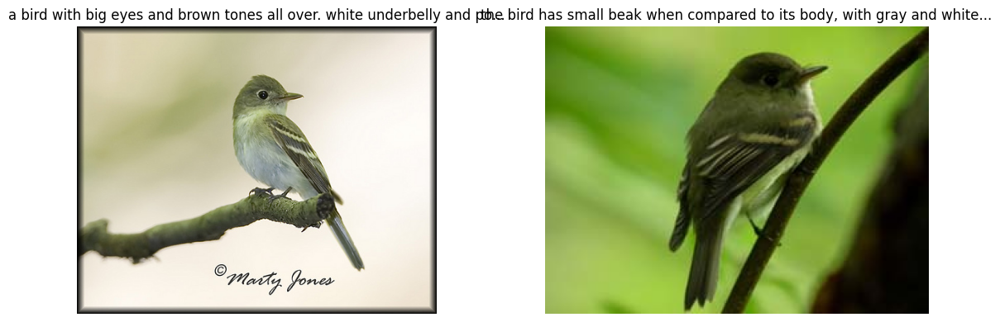

In [ ]:
from matplotlib import pyplot as plt

fig, axes = plt.subplots(1, len(images), figsize=(12, 4))
for ax, img, txt in zip(axes, images, texts):
    ax.imshow(img)
    ax.set_title(f"{txt[:70]}...")
    ax.axis("off")
plt.tight_layout()
plt.show()

**Вывод:** Вроде ок

In [ ]:
BATCH_SIZE = 1024

model = model.to(device)

def collate_fn(batch):
    images = [item["image"] for item in batch]
    texts = [item["text"] for item in batch]

    image_tensors = torch.stack([preprocess(img) for img in images])
    text_tensors = tokenizer(texts)

    return image_tensors, text_tensors

dataloader = DataLoader(
    ds["train"],
    batch_size=BATCH_SIZE,
    collate_fn=collate_fn,
    shuffle=False,
)

all_image_embeddings = []
all_text_embeddings = []

model.eval()
with torch.no_grad():
    for image_batch, text_batch in tqdm(dataloader, desc="Encoding"):
        image_batch = image_batch.to(device)
        text_batch = text_batch.to(device)

        img_emb = model.encode_image(image_batch)
        txt_emb = model.encode_text(text_batch)

        img_emb /= img_emb.norm(dim=-1, keepdim=True)
        txt_emb /= txt_emb.norm(dim=-1, keepdim=True)

        all_image_embeddings.append(img_emb.cpu().numpy())
        all_text_embeddings.append(txt_emb.cpu().numpy())

image_embeddings = np.concatenate(all_image_embeddings, axis=0)
text_embeddings = np.concatenate(all_text_embeddings, axis=0)

Encoding: 100%|██████████| 12/12 [02:23<00:00, 11.92s/it]


In [ ]:
image_embeddings.shape

(11787, 512)

In [ ]:
text_embeddings.shape

(11787, 512)

In [ ]:
np.save("image_embeddings.npy", image_embeddings)
np.save("text_embeddings.npy", text_embeddings)

### Задание 3 (0.5 балла).

Соберите картинки и получившиеся эмбеддинги в датасеты. Сохраните два датасета: один только с изображениями, другой - с изображениями и эмбеддингами подписей.

- Сконвертируйте картинки в соответствующие `codes` (используйте функции выше)

Hint: внимательно посмотрите на кол-во каналов в изображениях датасета и размеры картинок, предобработайте картинки перед подачей в VQ-VAE

Hint 2: сначала используется сабсет из вашего датасета для дебага, потому что датасет конвертируется долго, после дебага используйте весь

In [ ]:
vqvae.config

FrozenDict([('in_channels', 3),
            ('out_channels', 3),
            ('down_block_types',
             ['DownEncoderBlock2D',
              'DownEncoderBlock2D',
              'DownEncoderBlock2D',
              'AttnDownEncoderBlock2D']),
            ('up_block_types',
             ['AttnUpDecoderBlock2D',
              'UpDecoderBlock2D',
              'UpDecoderBlock2D',
              'UpDecoderBlock2D']),
            ('block_out_channels', [64, 128, 256, 512]),
            ('layers_per_block', 2),
            ('act_fn', 'silu'),
            ('latent_channels', 256),
            ('sample_size', 32),
            ('num_vq_embeddings', 4096),
            ('norm_num_groups', 32),
            ('vq_embed_dim', 128),
            ('scaling_factor', 0.18215),
            ('norm_type', 'group'),
            ('mid_block_add_attention', True),
            ('lookup_from_codebook', False),
            ('force_upcast', False),
            ('_use_default_values',
             ['mid_block_ad

In [ ]:
sample_img = ds["train"][0]["image"]
print("Image mode:", sample_img.mode)
print("Image size:", sample_img.size)

Image mode: RGB
Image size: (500, 400)


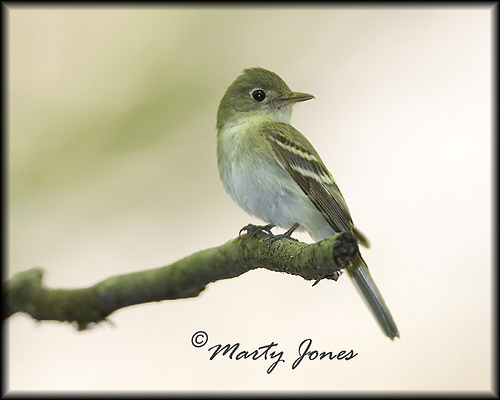

In [ ]:
sample_img

In [ ]:
from torchvision import transforms

def preprocess_image_for_vqvae(img, target_size=256):
    """
    Приводит изображение к квадратному виду, сохраняя пропорции:
    1. Делает center crop до минимальной стороны (400x400)
    2. Ресайзит до 512x512
    """
    if img.mode != "RGB":
        img = img.convert("RGB")

    # центральный квадратный кроп
    width, height = img.size
    min_side = min(width, height)
    left = (width - min_side) // 2
    top = (height - min_side) // 2
    img = img.crop((left, top, left + min_side, top + min_side))

    # ресайз до 512x512
    transform = transforms.Compose([
        transforms.Resize((target_size, target_size), antialias=True),
        transforms.ToTensor(),
    ])
    return transform(img)

In [ ]:
def collate_for_vqvae(batch):
    images = [preprocess_image_for_vqvae(item["image"], target_size=256) for item in batch]
    return torch.stack(images) # (B, 3, 512, 512)

def extract_codes_from_dataset(dataset, vqvae, batch_size=32, device="cuda"):
    vqvae = vqvae.to(device)
    dataloader = DataLoader(dataset, batch_size=batch_size, collate_fn=collate_for_vqvae)

    all_codes = []
    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Extracting VQ-VAE codes"):
            batch = batch.to(device)
            codes = img_to_codes(batch, vqvae)
            all_codes.append(codes.cpu().numpy())
    return np.concatenate(all_codes, axis=0)

In [ ]:
# берём 10 изображений
debug_subset = ds["train"].select(range(10))

# считаем коды
debug_codes = extract_codes_from_dataset(debug_subset, vqvae, batch_size=4)

Extracting VQ-VAE codes: 100%|██████████| 3/3 [00:01<00:00,  1.96it/s]

debug_codes.shape (10, 32, 32)


In [ ]:
debug_codes

array([[[1131, 3545, 2520, ..., 2520, 2891, 1649],
        [3165,  822, 1398, ..., 2921, 3667,  934],
        [ 113,  645, 3491, ..., 1845, 1590, 2559],
        ...,
        [ 380, 2968,  383, ..., 1974,  559, 1046],
        [2100, 2535, 1966, ...,  844, 2273, 2173],
        [3818, 3929, 3320, ..., 3320, 3058,   47]],

       [[2079, 1320, 3906, ...,  156, 1175, 3357],
        [3883, 2568, 2462, ...,  953, 1028, 1427],
        [3037, 1487, 1175, ..., 3729, 3838,  645],
        ...,
        [3559, 3735, 1266, ..., 2755, 2884, 1004],
        [2472, 1472, 1734, ..., 3986, 2807,  105],
        [1135,  329, 1151, ..., 1574, 3101, 1826]],

       [[3919, 1343, 1249, ...,  385, 3433, 2404],
        [ 480, 1455, 3243, ...,  161, 2064,  194],
        [2152, 3180, 3262, ..., 3767, 2588, 2568],
        ...,
        [2584, 3577, 3357, ..., 3300,  920, 3258],
        [3948, 3020, 1096, ..., 3000, 3491,  536],
        [2357, 1487, 4013, ..., 3603,  782,  798]],

       ...,

       [[1039,  931, 284

In [ ]:
debug_codes.shape

(10, 32, 32)

In [ ]:
full_codes = extract_codes_from_dataset(ds["train"], vqvae, batch_size=32)

Extracting VQ-VAE codes: 100%|██████████| 369/369 [05:30<00:00,  1.12it/s]


In [ ]:
full_codes.shape

(11787, 32, 32)

In [ ]:
np.save("vq_codes_full.npy", full_codes)

In [ ]:
text_embs = np.load("text_embeddings.npy") # (11787, 512)

# только картинки
ds_images_only = ds["train"].remove_columns(["text", "label"])
ds_images_only.save_to_disk("dataset_images_only")

# картинки + эмбеддинги текста
ds_with_emb = ds["train"].add_column("text_embedding", text_embs.tolist())
ds_with_emb = ds_with_emb.remove_columns(["text", "label"])
ds_with_emb.save_to_disk("dataset_images_with_text_embeddings")

Saving the dataset (0/3 shards):   0%|          | 0/11787 [00:00<?, ? examples/s]

Saving the dataset (0/3 shards):   0%|          | 0/11787 [00:00<?, ? examples/s]

✅ Оба датасета сохранены!


In [ ]:
!zip -r dataset_images_only.zip dataset_images_only/
!zip -r dataset_images_with_text_embeddings.zip dataset_images_with_text_embeddings/

  adding: dataset_images_only/ (stored 0%)
  adding: dataset_images_only/data-00000-of-00003.arrow (deflated 2%)
  adding: dataset_images_only/state.json (deflated 54%)
  adding: dataset_images_only/data-00001-of-00003.arrow (deflated 1%)
  adding: dataset_images_only/dataset_info.json (deflated 65%)
  adding: dataset_images_only/data-00002-of-00003.arrow (deflated 2%)
  adding: dataset_images_with_text_embeddings/ (stored 0%)
  adding: dataset_images_with_text_embeddings/data-00000-of-00003.arrow (deflated 3%)
  adding: dataset_images_with_text_embeddings/state.json (deflated 54%)
  adding: dataset_images_with_text_embeddings/data-00001-of-00003.arrow (deflated 3%)
  adding: dataset_images_with_text_embeddings/dataset_info.json (deflated 65%)
  adding: dataset_images_with_text_embeddings/data-00002-of-00003.arrow (deflated 3%)


In [ ]:
from google.colab import files

files.download('dataset_images_only.zip')
files.download('dataset_images_with_text_embeddings.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Задание 4 (2 балла).

- Обучите [модель из семинара (PixelCNN)](https://colab.research.google.com/drive/1EIsBxlTcz3ZB0j-ZxN1gWD2dSQq6krPj?usp=sharing) только на `codes` птиц. Модифицируйте размерности тензоров в модели, где это необходимо - чтобы она корректно работала с данными изображениями (обратите внимание на то, какие дискретные числа должны предсказывать ваша модель)

- Сделайте обучаемый `nn.Embedding` для `codes` перед подачей в слои свертки

- Вы можете менять гиперпараметры для улучшения качества генерации

- Выведите на экран 10 сгенерированных картинок, оцените результат, напишите выводы

Hint: добавьте конвертацию кодов в изображения в функцию отрисовки картинок, а не в `sample`.

In [17]:
# ORIGINAL
class MaskedConvolution(nn.Module):

    def __init__(self, c_in, c_out, mask, **kwargs):
        """
        Implements a convolution with mask applied on its weights.
        Inputs:
            c_in - Number of input channels
            c_out - Number of output channels
            mask - Tensor of shape [kernel_size_H, kernel_size_W] with 0s where
                   the convolution should be masked, and 1s otherwise.
            kwargs - Additional arguments for the convolution
        """
        super().__init__()
        # For simplicity: calculate padding automatically
        kernel_size = (mask.shape[0], mask.shape[1])
        dilation = 1 if "dilation" not in kwargs else kwargs["dilation"]
        padding = tuple([dilation*(kernel_size[i]-1)//2 for i in range(2)])
        # Actual convolution
        self.conv = nn.Conv2d(c_in, c_out, kernel_size, padding=padding, **kwargs)

        # Mask as buffer => it is no parameter but still a tensor of the module
        # (must be moved with the devices)
        self.register_buffer('mask', mask[None,None])

    def forward(self, x):
        self.conv.weight.data *= self.mask # Ensures zero's at masked positions
        return self.conv(x)

In [18]:
# ORIGINAL
class VerticalStackConvolution(MaskedConvolution):

    def __init__(self, c_in, c_out, kernel_size=3, mask_center=False, **kwargs):
       # Создаётся квадратная матрица из единиц (kernel_size × kernel_size), которая будет маской.
       # Все элементы ниже центральной строки зануляются (=0) → это значит, что фильтр не может смотреть вниз
       # (т.е. на пиксели ниже текущего).
        mask = torch.ones(kernel_size, kernel_size)
        mask[kernel_size//2+1:,:] = 0

       # Если mask_center=True, то обнуляется центральная строка, то есть пиксель не видит даже себя самого.
       # Это используется при самой первой свёртке, чтобы не допустить “подглядывания” текущего значения.
        if mask_center:
            mask[kernel_size//2,:] = 0

        super().__init__(c_in, c_out, mask, **kwargs)

class HorizontalStackConvolution(MaskedConvolution):

    def __init__(self, c_in, c_out, kernel_size=3, mask_center=False, **kwargs):
        mask = torch.ones(1,kernel_size)
        mask[0,kernel_size//2+1:] = 0

        if mask_center:
            mask[0,kernel_size//2] = 0

        super().__init__(c_in, c_out, mask, **kwargs)

In [19]:
# ORIGINAL
class GatedMaskedConv(nn.Module):

    def __init__(self, c_in, **kwargs):
        """
        Gated Convolution block implemented the computation graph shown above.
        """
        super().__init__()
        self.conv_vert = VerticalStackConvolution(c_in, c_out=2*c_in, **kwargs)
        self.conv_horiz = HorizontalStackConvolution(c_in, c_out=2*c_in, **kwargs)
        self.conv_vert_to_horiz = nn.Conv2d(2*c_in, 2*c_in, kernel_size=1, padding=0)
        self.conv_horiz_1x1 = nn.Conv2d(c_in, c_in, kernel_size=1, padding=0)

    def forward(self, v_stack, h_stack):
        # Vertical stack (left)
        v_stack_feat = self.conv_vert(v_stack)
        v_val, v_gate = v_stack_feat.chunk(2, dim=1)
        v_stack_out = torch.tanh(v_val) * torch.sigmoid(v_gate)

        # Horizontal stack (right)
        h_stack_feat = self.conv_horiz(h_stack)
        h_stack_feat = h_stack_feat + self.conv_vert_to_horiz(v_stack_feat)
        h_val, h_gate = h_stack_feat.chunk(2, dim=1)
        h_stack_feat = torch.tanh(h_val) * torch.sigmoid(h_gate)
        h_stack_out = self.conv_horiz_1x1(h_stack_feat)
        h_stack_out = h_stack_out + h_stack

        return v_stack_out, h_stack_out

In [ ]:
class PixelCNN(pl.LightningModule):
    def __init__(self, n_embeddings, c_in=1, c_hidden=64):
        """
        n_embeddings: размер кодбука VQ-VAE (vqvae.quantize.n_e)
        c_in: количество входных "каналов" - для кодов это 1 (но не RGB!)
        c_hidden: количество скрытых каналов (как в семинаре)
        """
        super().__init__()
        self.save_hyperparameters()

        # обучаемый эмбеддинг-слой для кодов
        self.embedding = nn.Embedding(n_embeddings, c_hidden)

        self.conv_vstack = VerticalStackConvolution(c_hidden, c_hidden, mask_center=True)
        self.conv_hstack = HorizontalStackConvolution(c_hidden, c_hidden, mask_center=True)

        self.conv_layers = nn.ModuleList([
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=4),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden)
        ])

        self.conv_out = nn.Conv2d(c_hidden, n_embeddings, kernel_size=1, padding=0)

        self.example_input_array = torch.zeros((1, 32, 32), dtype=torch.long)

    def forward(self, x):
        """
        Forward codes through model and return logits for each code.
        Inputs:
            x - Tensor of discrete codes with integer values between 0 and n_embeddings-1 [B, H, W]
        """
        # преобразуем коды в эмбеддинги
        x = self.embedding(x) # [B, H, W, c_hidden]
        x = x.permute(0, 3, 1, 2) # [B, c_hidden, H, W]

        v_stack = self.conv_vstack(x)
        h_stack = self.conv_hstack(x)

        for layer in self.conv_layers:
            v_stack, h_stack = layer(v_stack, h_stack)

        out = self.conv_out(F.elu(h_stack))
        return out

    def calc_likelihood(self, x):
        """Forward pass with bpd likelihood calculation"""
        pred = self.forward(x) # [B, n_emb, H, W]
        nll = F.cross_entropy(pred, x, reduction='none') # [B, H, W]
        bpd = nll.mean(dim=[1, 2]) * np.log2(np.exp(1))
        return bpd.mean() # средний bpd по батчу

    @torch.no_grad()
    def sample(self, img_shape, temperature=1.):
        """
        Sampling function for the autoregressive model.
        Inputs:
            img_shape - Shape of the codes to generate [B, H, W]
        """
        device = next(self.parameters()).device
        B, H, W = img_shape

        out_codes = torch.zeros((B, H, W), dtype=torch.long, device=device)

        # генерация по 1 пикселю
        for h in tqdm(range(H)):
            for w in range(W):
                current_part = out_codes[:, :h+1, :]

                if h < H-1 or w > 0:
                    pass


                logits = self.forward(current_part) # [B, n_emb, h+1, W]
                current_logits = logits[:, :, h, w] # [B, n_emb]
                current_logits = current_logits / temperature

                probs = F.softmax(current_logits, dim=-1)

                sampled = torch.multinomial(probs, num_samples=1).squeeze(-1)
                out_codes[:, h, w] = sampled

        return out_codes

    def configure_optimizers(self):
        optimizer = optim.Adam(self.parameters(), lr=1e-3)
        scheduler = optim.lr_scheduler.StepLR(optimizer, 1, gamma=0.99)
        return [optimizer], [scheduler]

    def training_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch[0])
        # print("loss:", loss)
        self.log('train_loss', loss, prog_bar=True, on_epoch=True, on_step=False)
        return loss

    def validation_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch[0])
        self.log('val_loss', loss, prog_bar=True, on_epoch=True, on_step=False)

    def test_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch[0])
        self.log('test_loss', loss)

In [ ]:
n_embeddings

4096

In [ ]:
# загрузка кодов
vq_codes_full_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/vq_codes_full.npy"
# path="vq_codes_full.npy" # colab

full_codes = np.load(vq_codes_full_path) # (11787, 32, 32)
full_codes = torch.tensor(full_codes, dtype=torch.long)

In [ ]:
# переобчение модели на 100 семплах
subset_codes = full_codes[:150]

train_codes = subset_codes[:100]
val_codes   = subset_codes[100:]

train_loader = DataLoader(TensorDataset(train_codes), batch_size=32, shuffle=True)
val_loader   = DataLoader(TensorDataset(val_codes),   batch_size=32, shuffle=False)

Переобучение на 100 семплах

In [ ]:
# размер кодбука
n_embeddings = vqvae.quantize.n_e

model = PixelCNN(n_embeddings=n_embeddings, c_hidden=256)

trainer = pl.Trainer(
    max_epochs=200,
    accelerator='gpu',
    devices=1,
    log_every_n_steps=1,
    enable_checkpointing=True,
    callbacks=[
        ModelCheckpoint(save_weights_only=True, monitor='train_loss', mode='min'),
        ModelCheckpoint(save_weights_only=True, monitor='val_loss', mode='min'),
        LearningRateMonitor("epoch")
    ]
  )
trainer.fit(model, train_loader, val_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃   ┃ Name        ┃ Type                       ┃ Params ┃ Mode  ┃ FLOPs ┃         In sizes ┃         Out sizes ┃
┡━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ 0 │ embedding   │ Embedding                  │  1.0 M │ train │     0 │      [1, 32, 32] │  [1, 32, 32, 256] │
│ 1 │ conv_vstack │ VerticalStackConvolution   │  590 K │ train │ 1.2 B │ [1, 256, 32, 32] │  [1, 256, 32, 32] │
│ 2 │ conv_hstack │ HorizontalStackConvolution │  196 K │ train │ 402 M │ [1, 256, 32, 32] │  [1, 256, 32, 32] │
│ 3 │ conv_layers │ ModuleList                 │ 13.3 M │ train │     0 │                ? │                 ? │
│ 4 │ conv_out    │ Conv2d                     │  1.1 M │ train │ 2.1 B │ [1, 256, 32, 32] │ [1, 4096, 32, 32] │
└───┴─────────────┴────────────────────────────┴────────┴───────┴───────┴──────────────────┴───────────────────┘

Trainable params: 16.2 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 16.2 M                                                                                               
Total estimated model params size (MB): 64                                                                         
Modules in train mode: 56                                                                                          
Modules in eval mode: 0                                                                                            
Total FLOPs: 31.0 B

Output()

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=200` reached.


In [ ]:
# параметры переобученной модели (200 эпох)
train_bpd = trainer.callback_metrics.get('train_loss', None)
val_bpd = trainer.callback_metrics.get('val_loss', None)

print(f"Финальный train_loss: {train_bpd.item():.4f}")
print(f"Финальный val_loss: {val_bpd.item():.4f}")

Финальный train_loss: 0.0140
Финальный val_loss: 25.6443


In [ ]:
# генерим коды
sampled_codes = model.sample(img_shape=(10, 32, 32), temperature=0.5)

vqvae_device = next(vqvae.parameters()).device
sampled_codes = sampled_codes.to(vqvae_device)

  0%|          | 0/32 [00:00<?, ?it/s]

In [ ]:
sampled_codes.shape

torch.Size([10, 32, 32])

In [ ]:
def generate_images(sampled_codes):
    """Генерирует список для хранения декодированных изображений"""
    generated_images_list = []

    for i in tqdm(range(sampled_codes.shape[0]), desc="Decoding codes"):
        with torch.no_grad():
            single_code = sampled_codes[i:i+1] # [1, 32, 32]

            single_image = codes_to_img(single_code, vqvae) # [1, 3, 256, 256]
            generated_images_list.append(single_image.cpu())

    return torch.cat(generated_images_list, dim=0)

In [ ]:
generated_images = generate_images(sampled_codes)

In [ ]:
generated_images.shape

torch.Size([10, 3, 256, 256])

In [ ]:
torch.cuda.empty_cache()

In [ ]:
def show_generated_images(images, title=None):
    """
    Отображает список изображений.

    Args:
        images: torch.Tensor формы [B, 3, H, W] в диапазоне [0, 1]
        title: заголовок графика
    """

    B = images.shape[0]
    n_cols = 5
    n_rows = (B + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 3, n_rows * 3))

    if n_rows == 1 and n_cols == 1:
        axes = [axes]
    elif n_rows == 1 or n_cols == 1:
        axes = axes.flatten()
    else:
        axes = axes.flatten()

    for i in range(B):
        img = images[i].cpu().detach().permute(1, 2, 0).numpy()
        img = np.clip(img, 0.0, 1.0)
        axes[i].imshow(img)
        axes[i].axis('off')

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    if title:
        fig.suptitle(title, fontsize=16)

    plt.tight_layout()
    plt.show()
    plt.close(fig)

In [ ]:
generated_images.shape

torch.Size([10, 3, 256, 256])

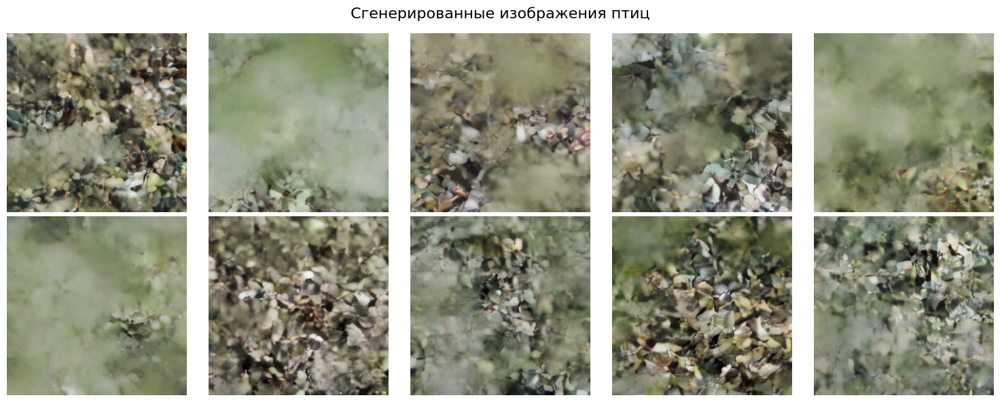

In [ ]:
# без добавления температуры к семплингу получилась плесневелая перловка (200 эпох, c_hidden=64)
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

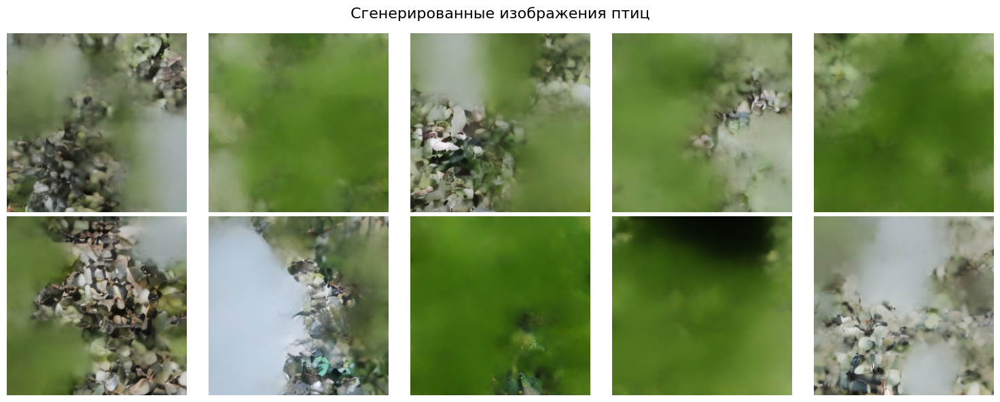

In [ ]:
# с температурой 0.7 (200 эпох, c_hidden=64). Тут видно немного фона
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

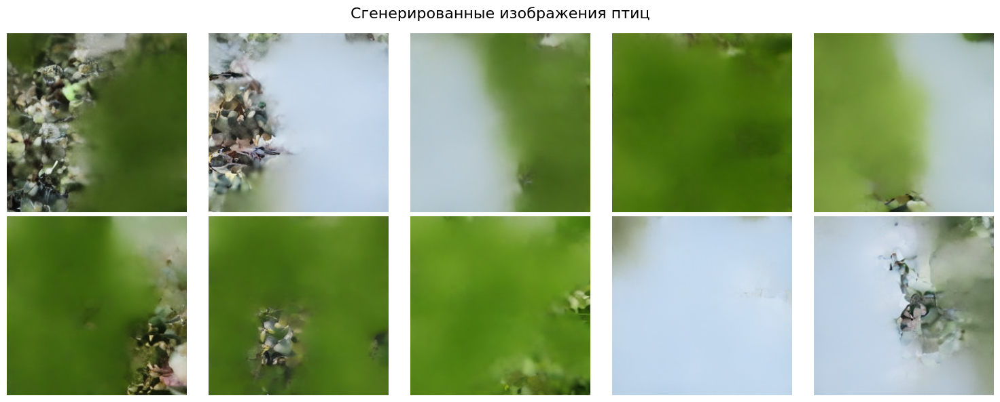

In [ ]:
# с температурой 0.5 (200 эпох, c_hidden=64). Фон стал ещё более заметный, но птичек нет
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

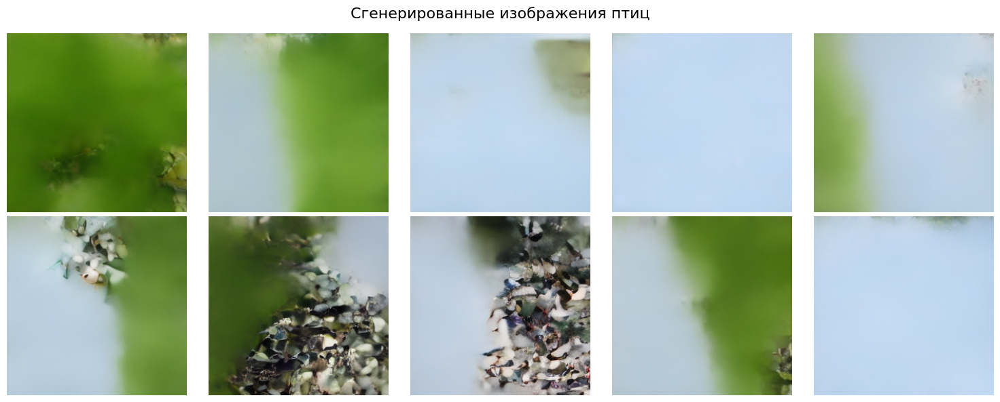

In [ ]:
# с температурой 0.1 (200 эпох, c_hidden=64)
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

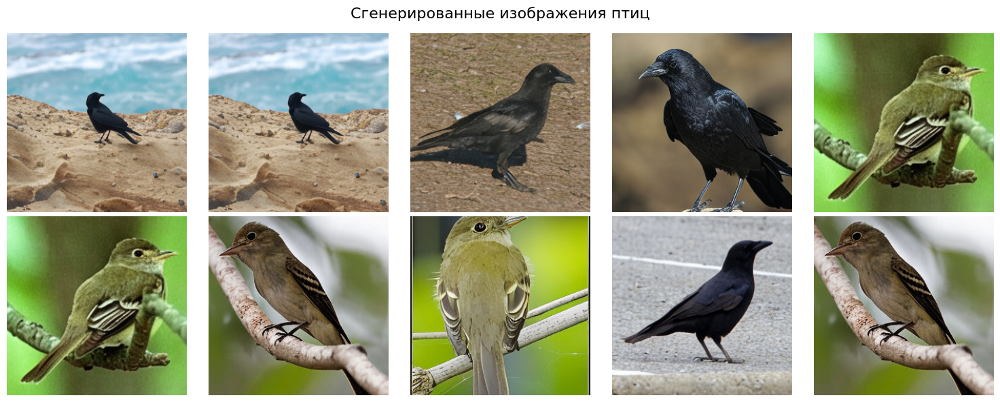

In [ ]:
# с температурой 0.5 (200 эпох, c_hidden=256)
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

In [21]:
full_codes_tensor

tensor([[[1131, 3545, 2520,  ..., 2520, 2891, 1649],
         [3165,  822, 1398,  ..., 2921, 3667,  934],
         [ 113,  645, 3491,  ..., 1845, 1590, 2559],
         ...,
         [ 380, 2968,  383,  ..., 1974,  559, 1046],
         [2100, 2535, 1966,  ...,  844, 2273, 2173],
         [3818, 3929, 3320,  ..., 3320, 3058,   47]],

        [[2079, 1320, 3906,  ...,  156, 1175, 3357],
         [3883, 2568, 2462,  ...,  953, 1028, 1427],
         [3037, 1487, 1175,  ..., 3729, 3838,  645],
         ...,
         [3559, 3735, 1266,  ..., 2755, 2884, 1004],
         [2472, 1472, 1734,  ..., 3986, 2807,  105],
         [1135,  329, 1151,  ..., 1574, 3101, 1826]],

        [[3919, 1343, 1249,  ...,  385, 3433, 2404],
         [ 480, 1455, 3243,  ...,  161, 2064,  194],
         [2152, 3180, 3262,  ..., 3767, 2588, 2568],
         ...,
         [2584, 3577, 3357,  ..., 3300,  920, 3258],
         [3948, 3020, 1096,  ..., 3000, 3491,  536],
         [2357, 1487, 4013,  ..., 3603,  782,  798]],

In [ ]:
# обучение на полном датасете
full_dataset = torch.utils.data.TensorDataset(full_codes)

# train и val (90% / 10%)
train_size = int(0.9 * len(full_dataset))
val_size = len(full_dataset) - train_size

train_codes, val_codes = torch.utils.data.random_split(
    full_dataset,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)

train_loader_full = DataLoader(train_codes, batch_size=32, shuffle=True, num_workers=4, pin_memory=True)
val_loader_full = DataLoader(val_codes, batch_size=32, shuffle=False, num_workers=4, pin_memory=True)

len(train_loader_full), len(val_loader_full)

(332, 37)

In [ ]:
n_embeddings = vqvae.quantize.n_e
c_hidden = 256

pixelcnn_full_vq_codes_model = PixelCNN(n_embeddings=n_embeddings, c_hidden=c_hidden)

In [ ]:
trainer = pl.Trainer(
    max_epochs=10,
    accelerator='gpu',
    devices=1,
    log_every_n_steps=5,
    enable_checkpointing=True,
    callbacks=[
        ModelCheckpoint(save_weights_only=True, monitor='train_loss', mode='min'),
        ModelCheckpoint(save_weights_only=True, monitor='val_loss', mode='min'),
        LearningRateMonitor("epoch")
    ]
  )
trainer.fit(pixelcnn_full_vq_codes_model, train_loader_full, val_loader_full)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name        | Type                       | Params | Mode  | In sizes         | Out sizes        
----------------------------------------------------------------------------------------------------------
0 | embedding   | Embedding                  | 1.0 M  | train | [1, 32, 32]      | [1, 32, 32, 256] 
1 | conv_vstack | VerticalStackConvolution   | 590 K  | train | [1, 256, 32, 32] | [1, 256, 32, 32] 
2 | conv_hstack | HorizontalStackConvolution | 196 K  | train | [1, 256, 32, 32] | [1, 256, 32, 32] 
3 | conv_layers | ModuleList                 | 13.3 M | train | ?                | ?                
4 | conv_o

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


In [19]:
# параметры модели, обученной на всём датасете (10 эпох)
train_bpd = trainer.callback_metrics.get('train_loss', None)
val_bpd = trainer.callback_metrics.get('val_loss', None)

print(f"train_loss: {train_bpd.item():.4f}")
print(f"val_loss: {val_bpd.item():.4f}")

train_loss: 9.7138
val_loss: 10.3856


In [ ]:
sampled_codes = pixelcnn_full_vq_codes_model.sample(img_shape=(10, 32, 32), temperature=0.6)

vqvae_device = next(vqvae.parameters()).device
sampled_codes = sampled_codes.to(vqvae_device)

  0%|          | 0/32 [00:00<?, ?it/s]

In [25]:
generated_images = generate_images(sampled_codes)

Decoding codes:   0%|          | 0/10 [00:00<?, ?it/s]

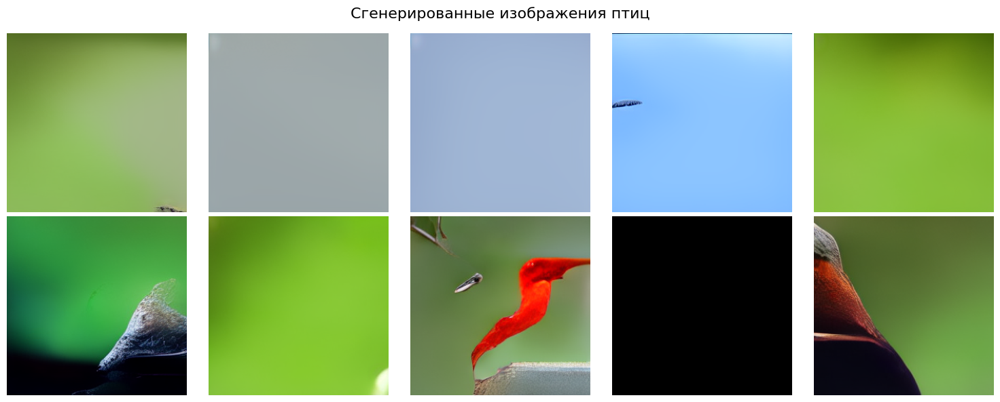

In [28]:
# с температурой 0.6 (10 эпох, c_hidden=256)
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

In [ ]:
sampled_codes = pixelcnn_full_vq_codes_model.sample(img_shape=(10, 32, 32), temperature=0.4)

vqvae_device = next(vqvae.parameters()).device
sampled_codes = sampled_codes.to(vqvae_device)

  0%|          | 0/32 [00:00<?, ?it/s]

In [30]:
generated_images = generate_images(sampled_codes)

Decoding codes:   0%|          | 0/10 [00:00<?, ?it/s]

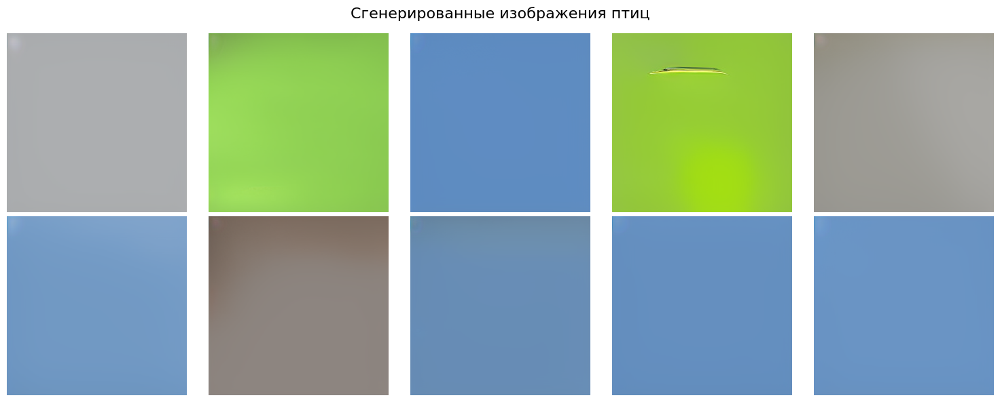

In [31]:
# с температурой 0.4 (10 эпох, c_hidden=256)
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

In [39]:
trainer.save_checkpoint("pixelcnn_full_vq_codes_model.ckpt")

### Задание 5 (3.5 балла).

- Добавьте сохраненные эмбеддинги подписей к архитектуре PixelCNN (это можно сделать любым способом - прибавить эмбеддинги, сконкатенировать их, использовать cross-attention или любой другой подход).

- Обучите такую conditional-модель на птицах и эмбеддингах текстов, выведите на экран по 10 промптам, похожим по формату на промпты из трейна, сгенерированные картинки. Оцените результат, напишите выводы (здесь вы тоже можете менять гиперпараметры модели)

**Hint:** для улучшения качества в последующих заданиях можете прочитать сначала условие задания 6

In [ ]:
class ConditionalPixelCNN(PixelCNN):
    def __init__(self, n_embeddings, text_embed_dim=512, c_in=1, c_hidden=64, guidance_prob=0.1):
        """
        n_embeddings: размер кодбука VQ-VAE (vqvae.quantize.n_e)
        text_embed_dim: размерность текстовых эмбеддингов (512)
        c_in: количество входных каналов (для кодов = 1)
        c_hidden: количество скрытых каналов
        guidance_prob: вероятность замены текстового эмбеддинга на пустой (classifier-free guidance)
        """
        super().__init__(n_embeddings, c_in, c_hidden)

        # гиперпараметры
        self.text_embed_dim = text_embed_dim
        self.guidance_prob = guidance_prob

        # проекция текстовых эмбеддингов в пространство скрытых состояний
        self.text_projection = nn.Sequential(
            nn.Linear(text_embed_dim, c_hidden),
            nn.ReLU(),
            nn.Linear(c_hidden, c_hidden)
        )

        # Создаем пустой эмбеддинг (для classifier-free guidance)
        self.register_buffer('empty_embedding', torch.zeros(1, text_embed_dim))

    def _apply_text_conditioning(self, h_stack, v_stack, text_embeddings):
        """Применяет текстовые эмбеддинги к скрытым состояниям"""
        text_features = self.text_projection(text_embeddings) # [B, c_hidden]

        # расширяем до размеров скрытых состояний [B, c_hidden, H, W]
        B, C, H, W = h_stack.shape
        text_features = text_features.view(B, C, 1, 1).expand(-1, -1, H, W)

        # добавляем к скрытым состояниям
        h_stack = h_stack + text_features
        v_stack = v_stack + text_features

        return v_stack, h_stack

    def forward(self, x, text_embeddings=None):
        """
        x: [B, H, W] - тензор с индексами кодов
        text_embeddings: [B, text_embed_dim] - текстовые эмбеддинги
        """
        if text_embeddings is None:
            # пустой текстовый эмбеддинг если его не передали
            text_embeddings = self.empty_embedding.expand(x.shape[0], -1).clone()

        # эмбеддинги для кодов
        x = self.embedding(x).permute(0, 3, 1, 2) # [B, H, W, c_hidden] -> [B, c_hidden, H, W]

        v_stack = self.conv_vstack(x)
        h_stack = self.conv_hstack(x)

        # текстовое условие
        v_stack, h_stack = self._apply_text_conditioning(v_stack, h_stack, text_embeddings)

        for layer in self.conv_layers:
            v_stack, h_stack = layer(v_stack, h_stack)
            # аплаим текстовое условие после каждого слоя
            v_stack, h_stack = self._apply_text_conditioning(v_stack, h_stack, text_embeddings)

        out = self.conv_out(h_stack)
        return out

    def _get_conditioned_embeddings(self, text_embeddings):
        """classifier-free guidance: с вероятностью guidance_prob заменяет текстовые эмбеддинги на пустые"""
        if self.training and self.guidance_prob > 0:
            mask = torch.rand(text_embeddings.shape[0], device=text_embeddings.device) < self.guidance_prob
            conditioned_embeddings = text_embeddings.clone()
            conditioned_embeddings[mask] = self.empty_embedding
            return conditioned_embeddings
        return text_embeddings

    def calc_bpd(self, codes, text_embeddings):
        """BPD с учетом текстовых эмбеддингов"""
        pred = self.forward(codes, text_embeddings) # [B, n_emb, H, W]
        nll = F.cross_entropy(pred, codes, reduction='none') # [B, H, W]
        bpd = nll.mean(dim=[1, 2]) * np.log2(np.exp(1))
        return bpd.mean() # скаляр: средний bpd по батчу

    def training_step(self, batch, batch_idx):
        """Используем calc_bpd с classifier-free guidance"""
        codes, text_embeddings = batch
        conditioned_embeddings = self._get_conditioned_embeddings(text_embeddings)
        loss = self.calc_bpd(codes, conditioned_embeddings)
        self.log('train_loss', loss, prog_bar=True, on_epoch=True, on_step=False)
        return loss

    def validation_step(self, batch, batch_idx):
        """Используем calc_bpd без guidance на валидации"""
        codes, text_embeddings = batch
        loss = self.calc_bpd(codes, text_embeddings)
        self.log('val_loss', loss, prog_bar=True, on_epoch=True, on_step=False)

    def sample(self, text_embeddings, img_shape, temperature=1.0, guidance_scale=7.5):
        """
        Генерация условных изображений с использованием classifier-free guidance

        text_embeddings: [B, text_embed_dim]
        img_shape: (B, H, W)
        temperature:
        guidance_scale: вес guidance (чем выше, тем сильнее условие влияет на генерацию)
        """
        self.eval()
        B, H, W = img_shape

        out_img = torch.zeros((B, H, W), dtype=torch.long, device=self.device)

        # пустые эмбеддинги для uncond семплинга
        empty_embeddings = self.empty_embedding.expand(B, -1).clone()

        with torch.no_grad():
            pbar = tqdm(total=H*W, desc="Sampling", unit="pixel")
            for h in range(H):
                for w in range(W):
                    cond_logits = self.forward(out_img, text_embeddings)
                    uncond_logits = self.forward(out_img, empty_embeddings)

                    # classifier-free guidance
                    logits = uncond_logits + guidance_scale * (cond_logits - uncond_logits)

                    # берем только текущий пиксель
                    current_logits = logits[:, :, h, w] / temperature

                    # softmax для получения вероятностей
                    probs = F.softmax(current_logits, dim=-1)

                    # сэмплируем следующий пиксель
                    next_pixel = torch.multinomial(probs, num_samples=1).squeeze(-1)

                    # добавляем в выходное изображение
                    out_img[:, h, w] = next_pixel

                    pbar.update(1)
            pbar.close()

        self.train()
        return out_img

In [ ]:
vq_codes_full_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/vq_codes_full.npy"
# vq_codes_full_path="vq_codes_full.npy" # colab
text_embeddings_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/text_embeddings.npy"
# text_embeddings_path="text_embeddings.npy" # colab

text_embeddings = np.load(text_embeddings_path)
text_embeddings = torch.tensor(text_embeddings, dtype=torch.float32)

full_codes = np.load(vq_codes_full_path)
full_codes = torch.tensor(full_codes, dtype=torch.long)

In [ ]:
full_codes = full_codes[:150]
text_embeddings = text_embeddings[:150]

# train/validation
train_codes = full_codes[:100]
val_codes = full_codes[100:]
train_text_embs = text_embeddings[:100]
val_text_embs = text_embeddings[100:]

train_dataset = TensorDataset(train_codes, train_text_embs)
val_dataset = TensorDataset(val_codes, val_text_embs)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)


n_embeddings = vqvae.quantize.n_e
model = ConditionalPixelCNN(
    n_embeddings=n_embeddings,
    text_embed_dim=512, # размерность CLIP эмбеддингов
    c_hidden=256,
    guidance_prob=0.1
)

In [16]:
full_codes.shape

torch.Size([150, 32, 32])

In [ ]:
trainer = pl.Trainer(
    max_epochs=150,
    accelerator='gpu',
    devices=1,
    check_val_every_n_epoch=5,
    callbacks=[
        ModelCheckpoint(
            dirpath="./checkpoints",
            filename="best-model-{epoch:02d}-{val_loss:.4f}",
            save_top_k=1,
            monitor="val_loss",
            mode="min",
            save_last=True,
            every_n_epochs=1
        ),
        LearningRateMonitor("epoch")
    ],
    log_every_n_steps=1
)
trainer.fit(model, train_loader, val_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:751: Checkpoint directory /kaggle/working/checkpoints exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type                       | Params | Mode  | In sizes         | Out sizes        
--------------------------------------------------------------------------------------------------------------
0 | embedding       | Embedding                  | 1.0 M  | train | [1, 32, 32]      | [1, 32, 32, 256] 
1 | conv_vstack     | VerticalStackConvolution   | 590 K  | train | [1, 256, 32, 32] | [1, 256, 32, 32] 
2 | conv_hstack     | Horizon

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=3` in the `DataLoader` to improve performance.
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=3` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=150` reached.


In [ ]:
# генерируем картинки для тестовых промптов
# 10 рандомных текстовых эмбеддингов из валидации
n_samples=5

sample_text_embs = val_text_embs[:n_samples]
generated_codes = model.sample(
    text_embeddings=sample_text_embs,
    img_shape=(n_samples, 32, 32),
    temperature=0.85,
    guidance_scale=7.5
)

Sampling:   0%|          | 0/32 [00:00<?, ?row/s]

In [34]:
sample_text_embs

tensor([[-4.5970e-02, -2.7915e-02,  5.9453e-02, -3.4165e-02, -3.9644e-02,
         -3.0892e-03,  5.1762e-03,  2.4795e-02,  6.5658e-03, -2.2220e-02,
         -2.0147e-03,  6.2400e-03,  2.9493e-02, -9.6564e-03,  1.3420e-02,
         -6.7279e-02,  6.3886e-02,  6.7828e-02, -5.2008e-02,  2.4667e-02,
          1.6087e-02,  4.1297e-02, -1.8862e-02,  2.5172e-02, -2.9048e-02,
         -1.8986e-02, -2.7183e-02, -1.7792e-02, -4.3976e-02,  1.5519e-02,
          4.9979e-02,  5.2537e-02,  1.6838e-02,  8.4448e-03,  2.6834e-02,
         -5.2028e-03, -3.5053e-02,  5.7883e-03,  4.2690e-02,  4.8174e-03,
         -1.2023e-02,  6.8069e-02, -5.1014e-02,  2.5787e-02, -1.0421e-02,
          7.2102e-03,  1.6305e-03,  4.2314e-02,  1.4149e-02, -3.0566e-03,
         -9.4737e-03, -4.7794e-03,  8.9389e-03,  2.9064e-02,  7.0332e-02,
         -2.2329e-02,  1.4393e-02, -4.7357e-02, -8.1696e-03, -7.9943e-03,
          5.7445e-02,  2.1685e-02,  1.2451e-02, -4.3833e-02,  2.1443e-03,
          2.8318e-02, -1.2644e-03, -1.

In [ ]:
vqvae_device = next(vqvae.parameters()).device
generated_codes = generated_codes.to(vqvae_device)

# коды в изображения
generated_images = generate_images(generated_codes)

Decoding codes:   0%|          | 0/5 [00:00<?, ?it/s]

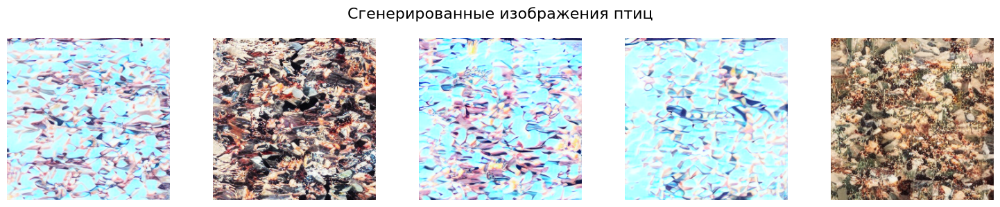

In [22]:
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

**Вывод:** переобучение у ConditionalPixelCNN + CFG не такое сильное, как у обычной реализации PixelCNN, метрика bpd на валидации и трейне не расходится так сильно, как было до этого. И в целом метрика стала лучше, однако птичек на картинке нет.

In [ ]:
text_embeddings = np.load(text_embeddings_path)
text_embeddings = torch.tensor(text_embeddings, dtype=torch.float32)

full_codes = np.load(vq_codes_full_path)  # (11787, 32, 32)
full_codes = torch.tensor(full_codes, dtype=torch.long)

In [ ]:
# train и val (90% / 10%)
train_size = int(0.9 * len(full_codes))
val_size = len(full_codes) - train_size

generator = torch.Generator().manual_seed(42)

train_codes, val_codes = torch.utils.data.random_split(
    full_codes,
    [train_size, val_size],
    generator=generator
)

train_text_embs, val_text_embs = torch.utils.data.random_split(
    text_embeddings,
    [train_size, val_size],
    generator=generator
)

X_train = train_codes.dataset[train_codes.indices]
y_train = train_text_embs.dataset[train_text_embs.indices]

X_val = val_codes.dataset[val_codes.indices]
y_val = val_text_embs.dataset[val_text_embs.indices]

len(X_train), len(X_val)

(10608, 1179)

In [38]:
len(y_train), len(y_val)

(10608, 1179)

In [ ]:
full_codes = np.load(vq_codes_full_path)
text_embeddings = np.load(text_embeddings_path)

full_codes_tensor = torch.tensor(full_codes, dtype=torch.long)
text_embeddings_tensor = torch.tensor(text_embeddings, dtype=torch.float32)

train_size = int(0.9 * len(full_codes_tensor))
val_size = len(full_codes_tensor) - train_size

generator = torch.Generator().manual_seed(42)
indices = torch.randperm(len(full_codes_tensor), generator=generator)

train_indices = indices[:train_size]
val_indices = indices[train_size:]

X_train = full_codes_tensor[train_indices]
y_train = text_embeddings_tensor[train_indices]
X_val = full_codes_tensor[val_indices]
y_val = text_embeddings_tensor[val_indices]

len(X_train), len(X_val)

(10608, 1179)

In [ ]:
train_dataset = TensorDataset(X_train, y_train)
val_dataset = TensorDataset(X_val, y_val)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=2, pin_memory=True)

n_embeddings = vqvae.quantize.n_e

cond_pixelcnn_full_vq_codes_model = ConditionalPixelCNN(
    n_embeddings=n_embeddings,
    text_embed_dim=512,
    c_hidden=256,
    guidance_prob=0.1
).to(device)

In [ ]:
trainer = pl.Trainer(
    max_epochs=10,
    accelerator='gpu',
    devices=1,
    check_val_every_n_epoch=5,
    callbacks=[
        ModelCheckpoint(
            dirpath="./checkpoints",
            filename="best-model-{epoch:02d}-{val_loss:.4f}",
            save_top_k=1,
            monitor="val_loss",
            mode="min",
            save_last=True,
            every_n_epochs=1
        ),
        LearningRateMonitor("epoch")
    ],
    log_every_n_steps=1
)
trainer.fit(cond_pixelcnn_full_vq_codes_model, train_loader, val_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type                       | Params | Mode  | In sizes         | Out sizes        
--------------------------------------------------------------------------------------------------------------
0 | embedding       | Embedding                  | 1.0 M  | train | [1, 32, 32]      | [1, 32, 32, 256] 
1 | conv_vstack     | VerticalStackConvolution   | 590 K  | train | [1, 256, 32, 32] | [1, 256, 32, 32] 
2 | conv_hstack     | HorizontalStackConvolution | 196 K  | train | [1, 256, 32, 32] | [1, 256, 32, 32] 
3 | conv_layers     | ModuleList                 | 13.3 M | train | ?                | ?   

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


In [ ]:
final_train_loss = trainer.callback_metrics['train_loss'].item()
final_val_loss = trainer.callback_metrics['val_loss'].item()

print(f"train_loss (BPD): {final_train_loss:.4f}")
print(f"val_loss (BPD): {final_val_loss:.4f}")

train_loss (BPD): 0.5777
val_loss (BPD): 0.3490


In [46]:
trainer.save_checkpoint("cond_pixelcnn_full_vq_codes_model.ckpt")

In [49]:
n_samples=5

cond_pixelcnn_full_vq_codes_model.to(device)
sample_text_embs = (val_text_embs[:n_samples]).to(device)

generated_codes = cond_pixelcnn_full_vq_codes_model.sample(
    text_embeddings=sample_text_embs,
    img_shape=(n_samples, 32, 32),
    temperature=0.85,
    guidance_scale=7.5
)

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

In [50]:
generated_images = generate_images(generated_codes)

Decoding codes:   0%|          | 0/5 [00:00<?, ?it/s]

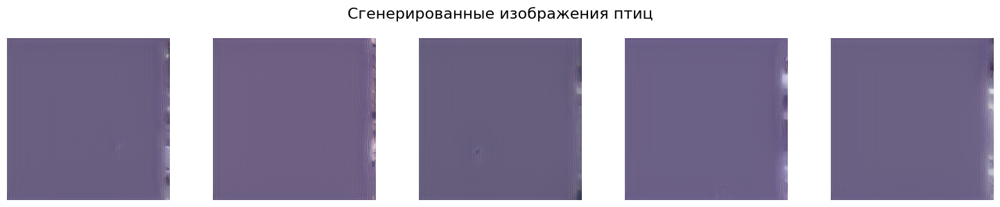

In [51]:
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

**Вывод:** Метрики ровные, не видно признаков переобучения, но модель не уловила суть того, чего от неё просят.

### Задание 6 (0.5 балла).

Добавьте [classifier-free guidance](https://colab.research.google.com/drive/1EIsBxlTcz3ZB0j-ZxN1gWD2dSQq6krPj?usp=sharing) на этапе инференса для увеличения разнообразия генерации. Проведите несколько экспериментов.

Для улучшения качества и разнообразия генерации (опционально) можно добавить [classifier-free guidance и на этапе обучения](https://education.yandex.ru/handbook/ml/article/diffuzionnye-modeli):
- для этого во время обучения эмбеддинг промпта заменяется с какой-то фиксированной вероятностью (например, 10%) на эмбеддинг пустого промпта



In [ ]:
# лоадим последний чекпоинт
model = ConditionalPixelCNN.load_from_checkpoint(
    "checkpoints/last.ckpt",
    # "checkpoints/best-model-epoch=XX-val_loss=YY.ckpt",
    n_embeddings=vqvae.quantize.n_e,
    text_embed_dim=512,
    c_hidden=256,
    guidance_prob=0.1
)
model.to(device)
model.eval()

val_text_embs = torch.tensor(np.load(text_embeddings_path)[10000:], dtype=torch.float32).to(device)
sampled_prompts = val_text_embs[:5]

# значения guidance_scale для сравнения
scales_to_test = [1.0, 3.0, 7.5, 10.0, 15.0]
results = {}

with torch.no_grad():
    for scale in scales_to_test:
        print(f"Генерация с guidance_scale = {scale}")
        generated_codes = model.sample(
            text_embeddings=sampled_prompts,
            img_shape=(5, 32, 32),
            temperature=0.85,
            guidance_scale=scale
        )
        generated_images = codes_to_img(generated_codes, vqvae)
        results[scale] = generated_images.cpu()

Генерация с guidance_scale = 1.0


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Генерация с guidance_scale = 3.0


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Генерация с guidance_scale = 7.5


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Генерация с guidance_scale = 10.0


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Генерация с guidance_scale = 15.0


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

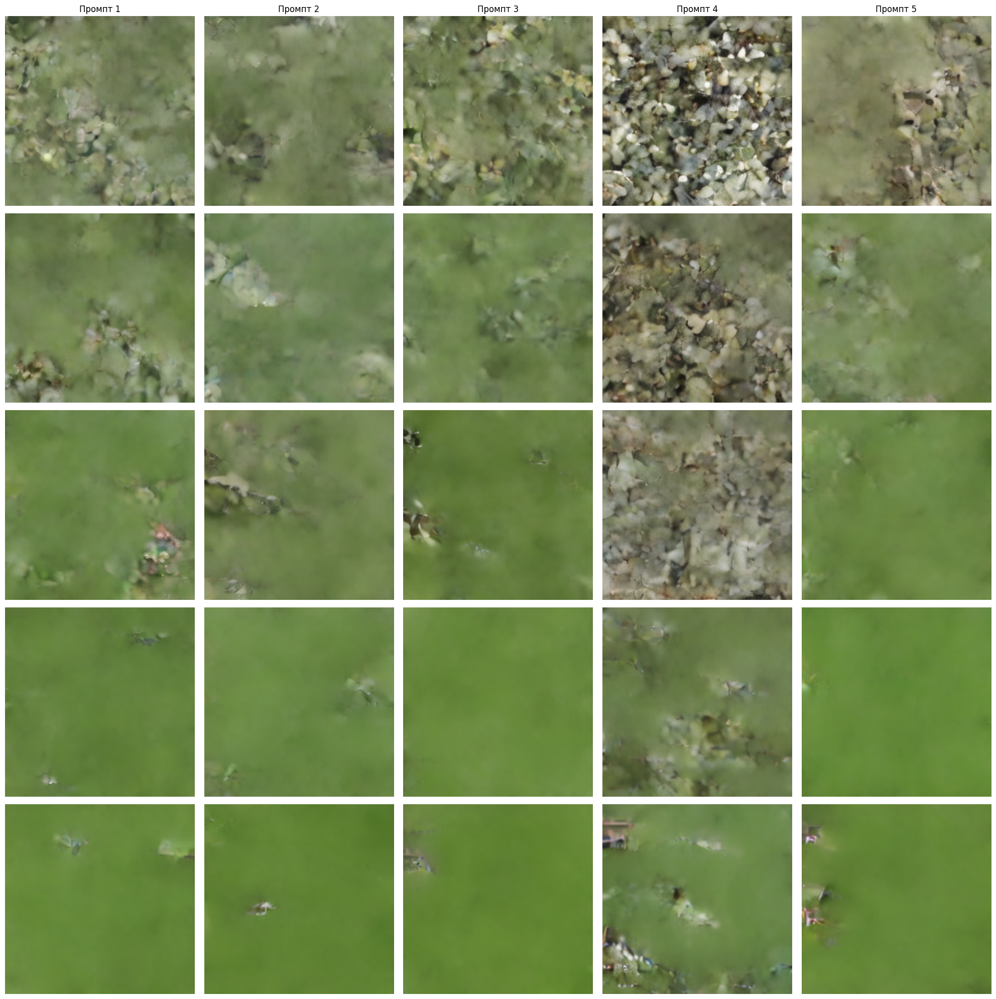

In [ ]:
fig, axes = plt.subplots(len(scales_to_test), 5, figsize=(20, 4 * len(scales_to_test)))

for i, scale in enumerate(scales_to_test):
    images_list = [transforms.ToPILImage()(results[scale][j]) for j in range(5)]
    
    for j in range(5):
        ax = axes[i][j]
        ax.imshow(images_list[j])
        ax.axis('off')
        
        if i == 0:
            ax.set_title(f"Промпт {j+1}")
    
    axes[i][0].set_ylabel(f"Scale={scale}", rotation=90, size='large')

plt.tight_layout()
plt.show()

### Задание 7 (0.5 балла)

Реализуйте какую-нибудь метрику качества генерации - на ваш выбор (это может быть Inception Score, Frechet Inception Distance, LPIPS или что-то другое). Вам необходимо привести работающий код для вычисления метрики и текстом пояснить как работает метрика.

Далее вычислите значение этой метрики для обученной в задании 5 модели и сделайте выводы.

**О метрике:** Реализуем метрику Frechet Inseption Distance (FID). Если брать объяснение с лекции, то звучит оно так: "Мы берём выход после слоёв свёртки (векторы длиной 2048) и работаем с ними. Берём пачку реальных картинок с собаками, берём пачку сгенерированных картинок с собаками, прогоняем через свёртки, усредняем по всей пачке картинок (находим среднее и стандартное отклонение), и с учётом средних считаем расстояние между реальными и сгенерированным картинкам. Чем более реальные картинки, тем меньше расстояние."

По факту, в реализации используется предобученная модель Inception v3 для построения распределения на признаках, которые извлекаются из одного из последних слоёв сети как для реальных изображений, так и для сгенерированных. Метрика FID оценивает расстояние между распределениями признаков.

In [ ]:
# HERE

class FIDCalculator:
    def __init__(self, device='cuda'):
        self.device = device
        # предобученная Inception-v3 без классификатора
        self.inception = inception_v3(pretrained=True, transform_input=False).to(device)
        self.inception.fc = nn.Identity() # удаляем последний слой
        self.inception.eval()
        self.to_pil = ToPILImage()

    @torch.no_grad()
    def get_features(self, images):
        """
        Извлечение признаков из изображений с помощью Inception-v3
        images: тензор [B, C, H, W], значения в [0,1]
        """

        # если черно-белые, конвертируем в RGB
        if images.shape[1] == 1:
            images = images.repeat(1, 3, 1, 1)
        elif images.shape[1] == 3 and images.min() < -0.5:  # [-1,1] -> [0,1]
            images = (images + 1) / 2

        # resize
        from torchvision.transforms import Resize
        resize = Resize((299, 299), antialias=True)
        images = resize(images)

        features = self.inception(images.to(self.device))
        return features.cpu().numpy()

    def calculate_fid(self, real_images, generated_images, batch_size=32):
        """
        Вычисление FID между двумя наборами изображений
        real_images: тензор [N, C, H, W] в диапазоне [0,1] или [-1,1]
        generated_images: тензор [M, C, H, W] в диапазоне [0,1] или [-1,1]
        """
        assert real_images.shape[1] in [1, 3], "Изображения должны быть 1 или 3 канала"
        assert generated_images.shape[1] in [1, 3], "Изображения должны быть 1 или 3 канала"

        max_samples = min(len(real_images), len(generated_images), 1000)
        real_images = real_images[:max_samples]
        generated_images = generated_images[:max_samples]

        real_loader = DataLoader(TensorDataset(real_images), batch_size=batch_size)
        gen_loader = DataLoader(TensorDataset(generated_images), batch_size=batch_size)

        real_features = []
        for (batch,) in real_loader:
            feat = self.get_features(batch)
            real_features.append(feat)
        real_features = np.concatenate(real_features, axis=0)

        gen_features = []
        for (batch,) in gen_loader:
            feat = self.get_features(batch)
            gen_features.append(feat)
        gen_features = np.concatenate(gen_features, axis=0)

        # средние и ковариации
        mu_real, sigma_real = real_features.mean(axis=0), np.cov(real_features, rowvar=False)
        mu_gen, sigma_gen = gen_features.mean(axis=0), np.cov(gen_features, rowvar=False)

        # FID
        ssdiff = np.sum((mu_real - mu_gen) ** 2)
        covmean = sqrtm(sigma_real.dot(sigma_gen))

        if np.iscomplexobj(covmean):
            covmean = covmean.real

        fid = ssdiff + np.trace(sigma_real + sigma_gen - 2 * covmean)
        return fid

In [ ]:
vq_codes_full_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/vq_codes_full.npy"
# # vq_codes_full_path="vq_codes_full.npy" # colab
text_embeddings_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/text_embeddings.npy"
# text_embeddings_path="text_embeddings.npy" # colab

# text_embeddings = np.load(text_embeddings_path)
# text_embeddings = torch.tensor(text_embeddings, dtype=torch.float32)

full_codes = np.load(vq_codes_full_path)
full_codes = torch.tensor(full_codes, dtype=torch.long)

text_embeddings = np.load(text_embeddings_path)
text_embeddings = torch.tensor(text_embeddings, dtype=torch.float32)

train_size = int(0.9 * len(full_codes))
text_embeddings_val = torch.tensor(text_embeddings[train_size:], dtype=torch.float32)

In [ ]:
# checkpoint_path = "cond_pixelcnn_full_vq_codes_model.ckpt" # colab
checkpoint_path = "/kaggle/working/cond_pixelcnn_full_vq_codes_model.ckpt"

cond_pixelcnn_full_vq_codes_model = ConditionalPixelCNN.load_from_checkpoint(
    checkpoint_path,
    n_embeddings=vqvae.quantize.n_e,
    text_embed_dim=512,
    c_hidden=256,
    guidance_prob=0.1

cond_pixelcnn_full_vq_codes_model.to(device)

ConditionalPixelCNN(
  (embedding): Embedding(4096, 256)
  (conv_vstack): VerticalStackConvolution(
    (conv): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  )
  (conv_hstack): HorizontalStackConvolution(
    (conv): Conv2d(256, 256, kernel_size=(1, 3), stride=(1, 1), padding=(0, 1))
  )
  (conv_layers): ModuleList(
    (0): GatedMaskedConv(
      (conv_vert): VerticalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (conv_horiz): HorizontalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(1, 3), stride=(1, 1), padding=(0, 1))
      )
      (conv_vert_to_horiz): Conv2d(512, 512, kernel_size=(1, 1), stride=(1, 1))
      (conv_horiz_1x1): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    )
    (1): GatedMaskedConv(
      (conv_vert): VerticalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2), dilation=(2, 2))
      )
      (conv_h

In [ ]:
cond_pixelcnn_full_vq_codes_model.eval()
vqvae.eval()

test_text_embs = torch.tensor(text_embeddings_val[:10]).to(device)

with torch.no_grad():
    generated_codes = cond_pixelcnn_full_vq_codes_model.sample(
        text_embeddings=test_text_embs,
        img_shape=(10, 32, 32),
        temperature=0.85,
        guidance_scale=7.5
    )
    generated_images = codes_to_img(generated_codes, vqvae) # [10, 3, 256, 256]
    generated_images = generated_images.clamp(0, 1) # нормализуем в [0,1]

real_images = []
for i in range(10):
    code = full_codes[i:i+1].to(device) # [1, 32, 32]
    with torch.no_grad():
        img = codes_to_img(code, vqvae) # [1, 3, 256, 256], значения [0,1]
    real_images.append(img.cpu())
real_images = torch.cat(real_images, dim=0)

fid_calculator = FIDCalculator(device=device)
fid_score = fid_calculator.calculate_fid(real_images, generated_images)

print(f"FID Score: {fid_score:.4f}")

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth
100%|██████████| 104M/104M [00:00<00:00, 187MB/s]  


FID Score: 236.9723


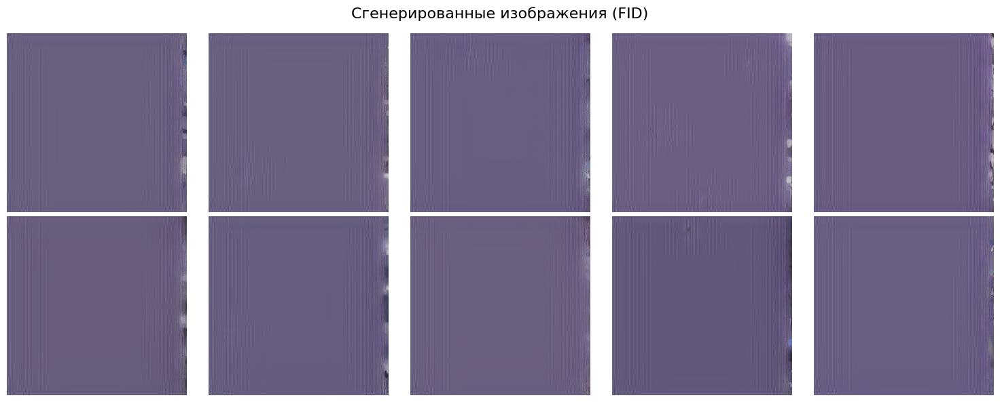

In [ ]:
show_generated_images(generated_images[:10], title="Сгенерированные изображения (FID)")

### Задание 8 (0.5 балла).

Можете делать любые действия для улучшения работы вашей модели (менять число слоев, параметры архитектуры - не отходя от концепции PixelCNN, менять гиперпараметры, делать аугментацию изображений и текстов и так далее).

Проведите эксперименты по улучшению качества модели - оценивайте качество модели с точки зрения:
- Реализованной в задании 7 метрики
- Визуально.

Мы ожидаем, что качество может не вырасти, но и не упадет.

In [ ]:
cond_pixelcnn_full_vq_codes_model = ConditionalPixelCNN.load_from_checkpoint(
    checkpoint_path,
    n_embeddings=vqvae.quantize.n_e,
    text_embed_dim=512,
    c_hidden=256,
    guidance_prob=0.1
)

cond_pixelcnn_full_vq_codes_model.to(device)

ConditionalPixelCNN(
  (embedding): Embedding(4096, 256)
  (conv_vstack): VerticalStackConvolution(
    (conv): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  )
  (conv_hstack): HorizontalStackConvolution(
    (conv): Conv2d(256, 256, kernel_size=(1, 3), stride=(1, 1), padding=(0, 1))
  )
  (conv_layers): ModuleList(
    (0): GatedMaskedConv(
      (conv_vert): VerticalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (conv_horiz): HorizontalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(1, 3), stride=(1, 1), padding=(0, 1))
      )
      (conv_vert_to_horiz): Conv2d(512, 512, kernel_size=(1, 1), stride=(1, 1))
      (conv_horiz_1x1): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    )
    (1): GatedMaskedConv(
      (conv_vert): VerticalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2), dilation=(2, 2))
      )
      (conv_h

In [ ]:
cond_pixelcnn_full_vq_codes_model.eval()
vqvae.eval()

test_text_embs = torch.tensor(text_embeddings_val[:10]).to(device)

with torch.no_grad():
    generated_codes = cond_pixelcnn_full_vq_codes_model.sample(
        text_embeddings=test_text_embs,
        img_shape=(10, 32, 32),
        temperature=1,
        guidance_scale=0.1
    )
    generated_images = codes_to_img(generated_codes, vqvae) # [100, 3, 256, 256]
    generated_images = generated_images.clamp(0, 1) # нормализуем в [0,1]

real_images = []
for i in range(10):
    code = full_codes[i:i+1].to(device) # [1, 32, 32]
    with torch.no_grad():
        img = codes_to_img(code, vqvae) # [1, 3, 256, 256], значения [0,1]
    real_images.append(img.cpu())
real_images = torch.cat(real_images, dim=0)

fid_calculator = FIDCalculator(device=device)
fid_score = fid_calculator.calculate_fid(real_images, generated_images)

print(f"FID Score: {fid_score:.4f}")

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

FID Score: 237.4556


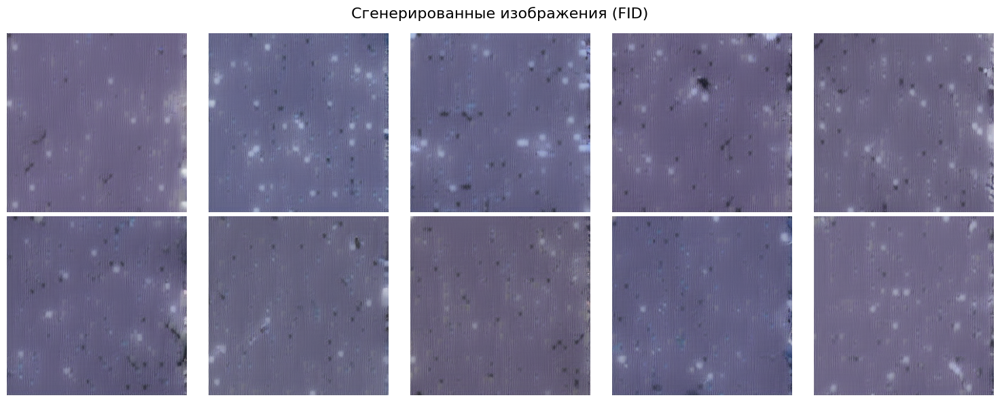

In [41]:
show_generated_images(generated_images[:10], title="Сгенерированные изображения (FID)")

**Вывод:** Температура влияет на то, как генерируются картинки, однако вместо птичек получились картинки звёздного неба. Вероятно, птичек не видно, потому что наступила ночь.

Далее решил поменять гиперпараметры и провести ещё одно обучение

In [16]:
# "вторая" попытка обучить модель:
# 10 эпох
# c_hidden=256, guidance_prob=0.1
#
# train_loss (BPD): 0.3533
# val_loss (BPD): 0.3548
checkpoint = torch.load("last-v2.ckpt", map_location=device)

In [17]:
n_embeddings = vqvae.quantize.n_e

cond_pixelcnn_full_vq_codes_model_v2 = ConditionalPixelCNN(
    n_embeddings=n_embeddings,
    text_embed_dim=512,
    c_hidden=256,
    guidance_prob=0.1
).to(device)

In [18]:
state_dict = checkpoint["state_dict"]
cond_pixelcnn_full_vq_codes_model_v2.load_state_dict(state_dict)
cond_pixelcnn_full_vq_codes_model_v2.eval()

ConditionalPixelCNN(
  (embedding): Embedding(4096, 256)
  (conv_vstack): VerticalStackConvolution(
    (conv): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  )
  (conv_hstack): HorizontalStackConvolution(
    (conv): Conv2d(256, 256, kernel_size=(1, 3), stride=(1, 1), padding=(0, 1))
  )
  (conv_layers): ModuleList(
    (0): GatedMaskedConv(
      (conv_vert): VerticalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (conv_horiz): HorizontalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(1, 3), stride=(1, 1), padding=(0, 1))
      )
      (conv_vert_to_horiz): Conv2d(512, 512, kernel_size=(1, 1), stride=(1, 1))
      (conv_horiz_1x1): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    )
    (1): GatedMaskedConv(
      (conv_vert): VerticalStackConvolution(
        (conv): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2), dilation=(2, 2))
      )
      (conv_h

In [19]:
# vq_codes_full_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/vq_codes_full.npy"
vq_codes_full_path="vq_codes_full.npy" # colab
# text_embeddings_path = "/kaggle/input/gendl-ht4-base-draft-03-clip/text_embeddings.npy"
text_embeddings_path="text_embeddings.npy" # colab

full_codes = np.load(vq_codes_full_path)
text_embeddings = np.load(text_embeddings_path)

full_codes_tensor = torch.tensor(full_codes, dtype=torch.long)
text_embeddings_tensor = torch.tensor(text_embeddings, dtype=torch.float32)

train_size = int(0.9 * len(full_codes_tensor))
val_size = len(full_codes_tensor) - train_size

generator = torch.Generator().manual_seed(42)
indices = torch.randperm(len(full_codes_tensor), generator=generator)

train_indices = indices[:train_size]
val_indices = indices[train_size:]

X_train = full_codes_tensor[train_indices]
y_train = text_embeddings_tensor[train_indices]
X_val = full_codes_tensor[val_indices]
y_val = text_embeddings_tensor[val_indices]

len(X_train), len(X_val)

(10608, 1179)

In [20]:
train_dataset = TensorDataset(X_train, y_train)
val_dataset = TensorDataset(X_val, y_val)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=2, pin_memory=True)

In [ ]:
n_samples=5

cond_pixelcnn_full_vq_codes_model_v2.to(device)
sample_text_embs = (text_embeddings_tensor[:n_samples]).to(device)

generated_codes = cond_pixelcnn_full_vq_codes_model_v2.sample(
    text_embeddings=sample_text_embs,
    img_shape=(n_samples, 32, 32),
    temperature=8.5, # 0.1, 4, 5, 7, 8.5, 15
    guidance_scale=6 # 0.1, 2, 4, 6, 7.5
)

generated_images = generate_images(generated_codes)

Decoding codes: 100%|██████████| 5/5 [00:00<00:00,  8.05it/s]


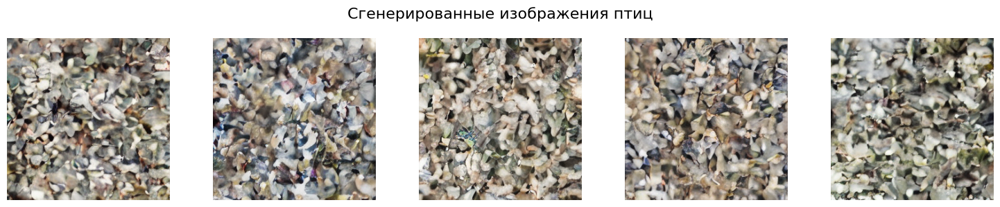

In [43]:
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

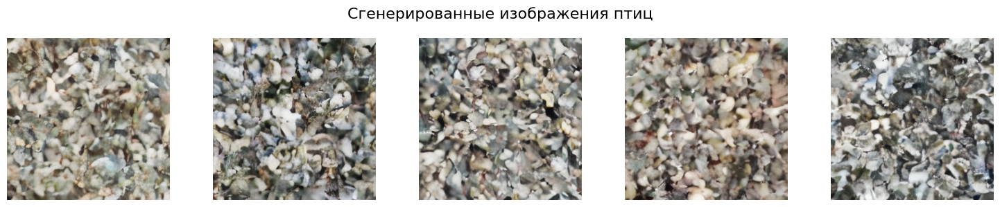

In [24]:
show_generated_images(generated_images, title="Сгенерированные изображения птиц")

**Вывод:** Несмотря на очень большое количество попыток семплить картинки с разными параметрами, что-то более внятное сгенерировать не удалось. Могу предположить, что модель немного недообучилась, но к сожалению, компьюта на проведения дополнительных экспериментов не хватило. Я бы попробовал поставить c_hidden=128, но запустить на большее количество эпох (например, на 20-30), возмонжно модель сможет выдать что-то лучшее, чем текущий результат.

### Задание 9 (1.5 балла).

Проанализируйте лучшую модель:

- Придумайте 5 разных признаков (например, цвет, вид оперения, длина клюва, лап и так далее) и посмотрите, будет ли модель их понимать благодаря текстовому эмбеддингу? (0.5 балла)

- Попробуйте добавлять в модель другие промпты - не связанные с птицами, или по-другому построенные (не "a photo of", а по-другому сформулированные). Как отрабатывает модель? (0.5 балла)

- Фиксируйте удачный промпт и проведите эксперименты по изменению веса guidance в classifer-free подходе. Сделайте выводы. (0.5 балла)

In [43]:
# Пишем пары промптов, которые будут сравнивать 2 разных промпта по каждому из следующих признаков:
# - Цвет птицы
# - Узор оперения
# - Длина клюва
# - Длина лап
# - Размер птицы

feature_prompts = {
    "color": [
        "a photo of a bird with red head and brown body",
        "a photo of a bird with blue head and brown body"
    ],
    "pattern": [
        "a photo of a bird with solid color wings",
        "a photo of a bird with striped wings"
    ],
    "beak_length": [
        "a photo of a bird with short beak",
        "a photo of a bird with long beak"
    ],
    "leg_length": [
        "a photo of a bird with short legs",
        "a photo of a bird with long legs"
    ],
    "size": [
        "a photo of a small bird",
        "a photo of a large bird"
    ]
}

In [ ]:
generated_images_by_feature = {}

for feature_name, (prompt1, prompt2) in feature_prompts.items():
    print(f"\n--- Генерация для признака '{feature_name}' ---")
    torch.cuda.empty_cache()
    
    text_input1 = clip_tokenizer(prompt1)
    text_input2 = clip_tokenizer(prompt2)
    
    with torch.no_grad():
        text_emb1 = clip_model.encode_text(text_input1)
        text_emb2 = clip_model.encode_text(text_input2)
    
    generated_codes1 = cond_pixelcnn_full_vq_codes_model.sample(
        text_embeddings=text_emb1.to(device),
        img_shape=(1, 32, 32),
        temperature=0.85,
        guidance_scale=7.5
    )
    generated_codes2 = cond_pixelcnn_full_vq_codes_model.sample(
        text_embeddings=text_emb2.to(device),
        img_shape=(1, 32, 32),
        temperature=0.85,
        guidance_scale=7.5
    )
    
    images1 = codes_to_img(generated_codes1, vqvae)
    images2 = codes_to_img(generated_codes2, vqvae)
    
    generated_images_by_feature[feature_name] = {
        "prompt1": images1,
        "prompt2": images2,
        "text1": prompt1,
        "text2": prompt2
    }


--- Генерация для признака 'color' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация для признака 'pattern' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация для признака 'beak_length' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация для признака 'leg_length' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация для признака 'size' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

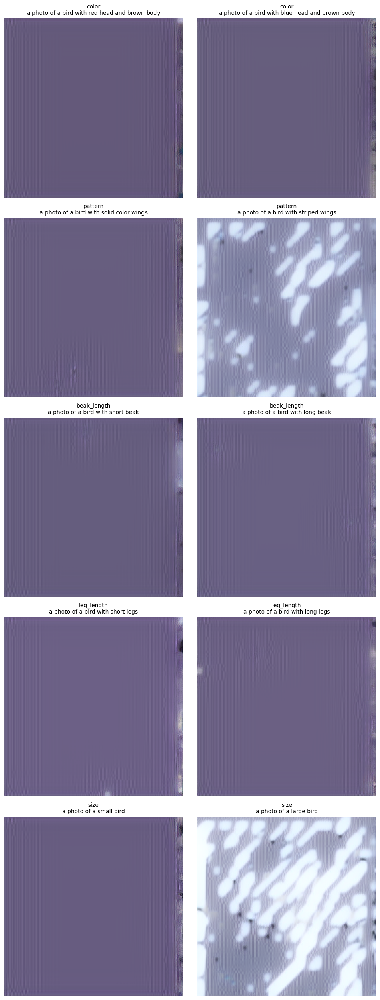

In [ ]:
fig, axes = plt.subplots(len(feature_prompts), 2, figsize=(10, 5 * len(feature_prompts)))

for i, (feature_name, data) in enumerate(generated_images_by_feature.items()):
    num_images = len(data["prompt1"])

    # первого промпта
    for j in range(num_images):
        ax = axes[i, 0] if j == 0 else axes[i, 0].inset_axes([0.33*j, 0, 0.33, 0.33])
        ax.imshow(data["prompt1"][j].cpu().detach().permute(1, 2, 0).numpy())
        ax.axis('off')
        if j == 0:
            ax.set_title(f"{feature_name}\n{data['text1']}", fontsize=10)

    # для второго промпта
    for j in range(num_images):
        ax = axes[i, 1] if j == 0 else axes[i, 1].inset_axes([0.33*j, 0, 0.33, 0.33])
        ax.imshow(data["prompt2"][j].cpu().detach().permute(1, 2, 0).numpy())
        ax.axis('off')
        if j == 0:
            ax.set_title(f"{feature_name}\n{data['text2']}", fontsize=10)

plt.tight_layout()
plt.show()

In [ ]:
# список промптов, которые отличаются от тех, что модель видела на трейне

out_of_domain_prompts = [
    "a photo of a car on the road",
    "an image depicting a beautiful sunset over the ocean",
    "here is a picture of a cat sitting on a windowsill",
    "a black and white sketch of a mountain landscape",
    "a photo of a bird with red head and brown body, but in space"
]

In [ ]:
generated_images_oob = []

for prompt in out_of_domain_prompts:
    print(f"\n--- Генерация для промпта: '{prompt}' ---")
    
    text_input = clip_tokenizer(prompt)
    
    with torch.no_grad():
        text_emb = clip_model.encode_text(text_input)
    
    generated_codes = cond_pixelcnn_full_vq_codes_model.sample(
        text_embeddings=text_emb.to(device),
        img_shape=(1, 32, 32),
        temperature=0.85,
        guidance_scale=7.5
    )
    
    images = codes_to_img(generated_codes, vqvae)
    generated_images_oob.append(images)
    
    print(f"Сгенерировано 2 изображения для '{prompt}'")


--- Генерация для промпта: 'a photo of a car on the road' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Сгенерировано 2 изображения для 'a photo of a car on the road'

--- Генерация для промпта: 'an image depicting a beautiful sunset over the ocean' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Сгенерировано 2 изображения для 'an image depicting a beautiful sunset over the ocean'

--- Генерация для промпта: 'here is a picture of a cat sitting on a windowsill' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Сгенерировано 2 изображения для 'here is a picture of a cat sitting on a windowsill'

--- Генерация для промпта: 'a black and white sketch of a mountain landscape' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Сгенерировано 2 изображения для 'a black and white sketch of a mountain landscape'

--- Генерация для промпта: 'a photo of a bird with red head and brown body, but in space' ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

Сгенерировано 2 изображения для 'a photo of a bird with red head and brown body, but in space'


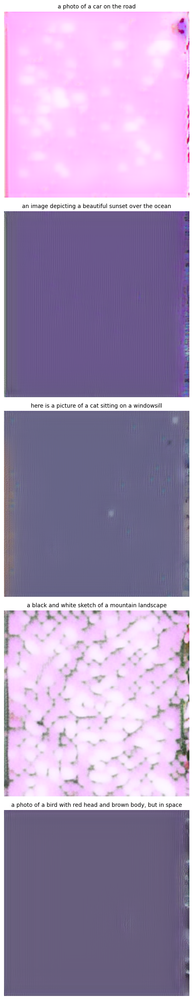

In [ ]:
fig, axes = plt.subplots(len(out_of_domain_prompts), 1, figsize=(5, 5 * len(out_of_domain_prompts)))

if len(out_of_domain_prompts) == 1:
    axes = [axes]

for i, (prompt, images) in enumerate(zip(out_of_domain_prompts, generated_images_oob)):
    ax = axes[i]
    ax.imshow(images[0].cpu().detach().permute(1, 2, 0).numpy())
    ax.axis('off')
    ax.set_title(prompt, fontsize=10)

plt.tight_layout()
plt.show()

In [96]:
base_prompt = "a photo of a bird with red head and brown body"
guidance_scales = [1.0, 3.0, 5.0, 7.5, 10.0]

print(f"Базовый промпт: '{base_prompt}'")
print(f"Значения guidance_scale: {guidance_scales}")

Базовый промпт: 'a photo of a bird with red head and brown body'
Значения guidance_scale: [1.0, 3.0, 5.0, 7.5, 10.0]


In [ ]:
generated_images_cfg = {}

cond_pixelcnn_full_vq_codes_model.eval()
vqvae.eval()

for w in guidance_scales:
    print(f"\n--- Генерация с guidance_scale = {w} ---")
    
    text_input = clip_tokenizer(base_prompt)
    
    with torch.inference_mode():
        text_emb = clip_model.encode_text(text_input).expand(1, -1)
        
        torch.cuda.empty_cache()
        
        generated_codes = cond_pixelcnn_full_vq_codes_model.sample(
            text_embeddings=text_emb.to(device),
            img_shape=(1, 32, 32),
            temperature=0.85,
            guidance_scale=w
        )
        
        images = codes_to_img(generated_codes, vqvae)
        
        generated_images_cfg[w] = images.cpu()
        
        torch.cuda.empty_cache()


--- Генерация с guidance_scale = 1.0 ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация с guidance_scale = 3.0 ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация с guidance_scale = 5.0 ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация с guidance_scale = 7.5 ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]


--- Генерация с guidance_scale = 10.0 ---


Sampling:   0%|          | 0/1024 [00:00<?, ?pixel/s]

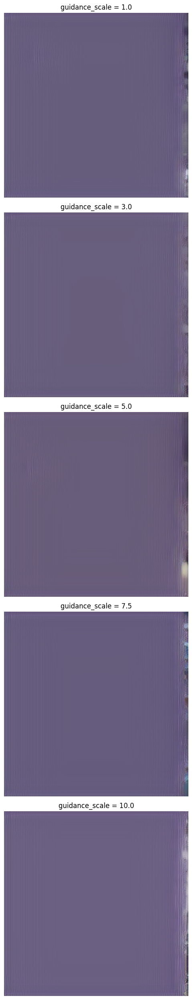

In [ ]:
fig, axes = plt.subplots(len(guidance_scales), 1, figsize=(5, 5 * len(guidance_scales)))

for i, w in enumerate(guidance_scales):
    ax = axes[i] if len(guidance_scales) > 1 else axes
    ax.imshow(generated_images_cfg[w][0].cpu().permute(1, 2, 0).numpy())
    ax.axis('off')
    ax.set_title(f"guidance_scale = {w}", fontsize=12)

plt.tight_layout()
plt.show()

**Выводы:** Сложно сделать выводы, поскольку модель не очень получилось нормально обучить. Возможно, можно поставить более низкий learning rate и поставить больше эпох, чтобы модель получше обучилась, однако, не факт, что подождав несколько часов я снова не получу фиолетовый картон =(. Здесь требуется больше времени на эксперименты, бесплатного компьюта не хватило, чтобы провести побольше экспериментов. При семплинге температура довольно сильно влияет на семплированный результат. При подаче промптов другого домена видно, что некоторые картинки генерируются не в рамках основного распределения тех данных, на которых обучалась модель, то есть модель реагирует и понимает, что от неё требуют что-то непривычное.